In [4]:
import os
import time
import json
import uuid
import base64
from io import BytesIO

import imageio
import numpy as np
from PIL import Image
# from fastapi import FastAPI, File, UploadFile
def no_accent_vietnamese(text):
    text1=[]
    for s in text:
#         s=s.replace(",","")
#         s=s.replace(";","")
#         s=s.replace(".","")
#         s=s.replace(" ","")
#         s=s.replace(":","")
        s = re.sub(r'[àáạảãâầấậẩẫăằắặẳẵ]', 'a', s)
        s = re.sub(r'[ÀÁẠẢÃĂẰẮẶẲẴÂẦẤẬẨẪ]', 'A', s)
        s = re.sub(r'[èéẹẻẽêềếệểễ]', 'e', s)
        s = re.sub(r'[ÈÉẸẺẼÊỀẾỆỂỄ]', 'E', s)
        s = re.sub(r'[òóọỏõôồốộổỗơờớợởỡ]', 'o', s)
        s = re.sub(r'[ÒÓỌỎÕÔỒỐỘỔỖƠỜỚỢỞỠ]', 'O', s)
        s = re.sub(r'[ìíịỉĩ]', 'i', s)
        s = re.sub(r'[ÌÍỊỈĨ]', 'I', s)
        s = re.sub(r'[ùúụủũưừứựửữ]', 'u', s)
        s = re.sub(r'[ƯỪỨỰỬỮÙÚỤỦŨ]', 'U', s)
        s = re.sub(r'[ỳýỵỷỹ]', 'y', s)
        s = re.sub(r'[ỲÝỴỶỸ]', 'Y', s)
        s = re.sub(r'[Đ]', 'D', s)
        s = re.sub(r'[đ]', 'd', s)
        text1.append(s)
    return text1
from backend.models import load_text_detect, load_text_recognize, load_saliency
from backend.backend_utils import (
    run_ocr1,
    NpEncoder,
    run_ocr,
    make_warp_img,
    resize_and_pad,
    get_group_text_line,
)
from backend.text_detect.config import craft_config
from backend.saliency.infer import run_saliency
import configs as cf
import cv2
import os
import random

def normalize_bbox(bbox, width, height):
     return [
         int(1000 * (bbox[0] / width)),
         int(1000 * (bbox[1] / height)),
         int(1000 * (bbox[2] / width)),
         int(1000 * (bbox[3] / height)),
     ]
from typing import List,Tuple
device="cuda"
def unnormalize_box(bbox, width, height):
    return [
        width * (bbox[0] / 1000),
        height * (bbox[1] / 1000),
        width * (bbox[2] / 1000),
        height * (bbox[3] / 1000),
    ]
from transformers import LayoutLMv2Processor,LayoutLMv2ForTokenClassification
def get_model():
#     /storage/quangtm/layoutlmv2/DataLayoutLm2/Checkpoints
    processor = LayoutLMv2Processor.from_pretrained("/data/quangtm/Graph_learning/model/layoutlmv2-base-uncased", revision="no_ocr")
    model = LayoutLMv2ForTokenClassification.from_pretrained("/storage/quangtm/KIE_invoice_minimal/Checkpoint") 
    model.eval()
    model.to(device)

    return model,processor

from PIL import Image , ImageDraw , ImageFont  
# Line thickness of 2 px
thickness = 2
model,processor=get_model()
net = load_saliency()
detector = load_text_recognize()
text_detector = load_text_detect()
list_path=os.listdir('/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images')
import copy
color=(255,0,0)
regex = r"^\,\d"
regex1=r"([0-9]{1})"
regex2 = r"^\.\d"
import re
j=0
labels=cf.labels
labels=['total_cost',
 'total_received',
 'address',
 'other',
 'unit',
 'item',
 'total refunds',
 'subitem',
 'time',
 'unitprice',
 'total_qty',
 'price',
 'seller',
 'phone']
label2id = {label: idx for idx, label in enumerate(labels)}
id2label = {idx: label for idx, label in enumerate(labels)}
get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
colors = get_colors(len(labels))
label2color = {label: colors[idx] for idx, label in enumerate(labels)}
from backend.backend_utils import create_merge_cells, get_request_api

#     break

In [5]:
labels

['total_cost',
 'total_received',
 'address',
 'other',
 'unit',
 'item',
 'total refunds',
 'subitem',
 'time',
 'unitprice',
 'total_qty',
 'price',
 'seller',
 'phone']

In [1]:
pwd

'/storage/quangtm/KIE_invoice_minimal'

In [ ]:
['total_cost',
 'total_received',
 'address',
 'other',
 'unit',
 'item',
 'total refunds',
 'subitem',
 'time',
 'unitprice',
 'total_qty',
 'price',
 'seller',
 'phone']

In [6]:

label2id = {label: idx for idx, label in enumerate(labels)}
id2label = {idx: label for idx, label in enumerate(labels)}
get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
colors = get_colors(len(labels))
label2color = {label: colors[idx] for idx, label in enumerate(labels)}
from backend.backend_utils import create_merge_cells, get_request_api


In [7]:
label2id

{'total_cost': 0,
 'total_received': 1,
 'address': 2,
 'other': 3,
 'unit': 4,
 'item': 5,
 'total refunds': 6,
 'subitem': 7,
 'time': 8,
 'unitprice': 9,
 'total_qty': 10,
 'price': 11,
 'seller': 12,
 'phone': 13}

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013iadlw.jpg
- Function run_ocr run in 2.43784904's
- Function get_group_text_line run in 0.14246082's


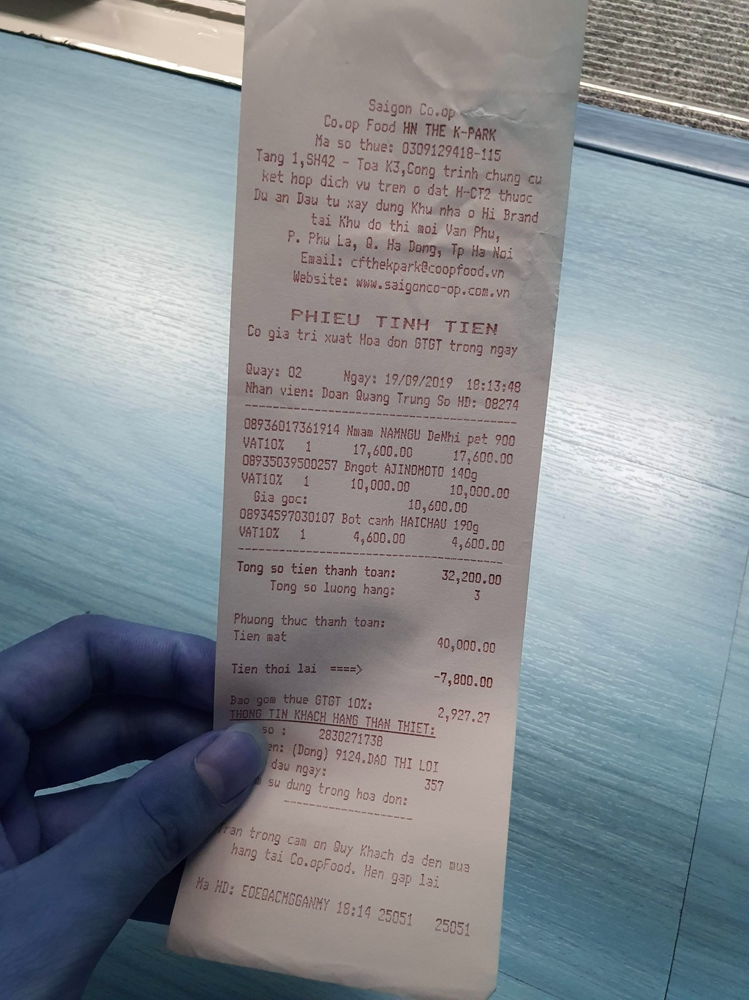

In [8]:
for i in range(len(list_path)):
    path_img='/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/'+list_path[i]

    #     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014qikqz.jpg"
    print("path_img",path_img)
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014zsypc.jpg"
    
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013pqnzb.jpg"
    img=cv2.imread(path_img)
    j=j+1
    random_id=j
#     img = resize_and_pad(img, size=1024, pad=False)
#     imageio.imwrite(os.path.join(cf.raw_img_dir, "{}.png".format(random_id)), img)

    # SALIENCY PREDICTION
#     mask_img = run_saliency(net, img)
#     img[~mask_img.astype(bool)] = 0.0
    
    # TRANSFORM AND WRAP IMAGE
#     warped_img = make_warp_img(img, mask_img)
    warped_img=img
    sub_img_fp = os.path.join(cf.cropped_img_dir, "{}.png".format(random_id))
    # print(sub_img_fp)
#     img=warped_img
    imageio.imwrite(sub_img_fp, warped_img)
    cells, heatmap, textboxes = run_ocr(
        text_detector, detector, img, craft_config
    )
    _, lines = get_group_text_line(heatmap, textboxes)
    # print(_, lines )
    for line_id, cell in zip(lines, cells):
        cell["group_id"] = line_id

    # CROP IMG AND UPDATE FINAL CELLS INFO
    sub_h_img, sub_w_img, _ = warped_img.shape
    img_info = dict()
    img_info["h_origin"] = sub_h_img
    img_info["w_origin"] = sub_w_img
    img_info["cells"] = cells
    group_ids = np.array([i for i in lines])
    merged_cells = []
    thickness = 2
    Box_sort_list_new,line_arr=[],[]
    merge_list=[]
    listtext=[]
    list_boxesa=[]
    for group_id in range(max(group_ids) + 1):
        indexes = np.where(group_ids == group_id)[0]
        
        
        if len(indexes) == 0:
            continue
        filter_cells = [cells[index] for index in indexes]
        filter_cells = sorted(filter_cells, key=lambda x: np.mean(x["poly"][::2]))
        so_list=[]
        text1=filter_cells[0]['vietocr_text']
        result = re.match(regex, text1)
        if result:
            result1a=True
        else:
            result = re.match(regex1, text1)
            if result:
                result1a=True
            else:
                result = re.match(regex2, text1)
                if result:
                    result1a=True
                else:
                    result1a=False
                    
        for i in range(1,len(filter_cells),1):
            text=filter_cells[i]['vietocr_text']
    #         print(text)
            result = re.match(regex, text)
            if result:
                result1=True
            else:
                result = re.match(regex1, text)
                if result:
                    result1=True
                else:
                    result = re.match(regex2, text)
                    if result:
                        result1=True
                    else:
                        result1=False

            
            if (result1a==True) and (result1==True):
    #             so_list.append(text)
                so_list.append(i-1) 
                so_list.append(i) 
            result1a=result1
        so_list=list(set(so_list))
        check=False
        boroi=False
        string_list=""
        id_text=-1
        for i in range(len(filter_cells)):
            id_text=id_text+1
            x1b,y1b,x2b,y2b,x3b,y3b,x4b,y4b=filter_cells[i-1]['poly']
            textn=filter_cells[i-1]['vietocr_text']
            group=filter_cells[i-1]['group_id']
            x1,y1,x2,y2,x3,y3,x4,y4=filter_cells[i]['poly']
            text=filter_cells[i]['vietocr_text']
            group=filter_cells[i]['group_id']
            if i not in so_list:
                if check==True :
                    listtext.append(string_list)
                    
                    list_boxesa.append([left_pont,top_point,x3b,y3b])
                    new_poly=[left_pont,top_point,x2b,y2b,x3b,y3b,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["vietocr_text"] = string_list
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    merged_cells.append(copy.deepcopy(tmp_cell))
                    string_list=""
                merged_cells.append(filter_cells[i])
                listtext.append(text)
                list_boxesa.append([x1,y1,x3,y3])
                check=False
            else:
    #             print(text)
                if (abs(x2b-x1)>min(abs(x2-x1),abs(x2b-x1b)) ) and (check==True):
                    listtext.append(string_list)
                    list_boxesa.append([left_pont,top_point,x3b,y3b])
                    new_poly=[left_pont,top_point,x2b,y2b,x3b,y3b,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["vietocr_text"] = string_list
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    merged_cells.append(copy.deepcopy(tmp_cell))
                
                    string_list=""
                    left_pont,top_point,right_point,bottom_point=x1,y1,x4,y4
                if check==False:
    #                 print("text123",text)
                    left_pont,top_point,right_point,bottom_point=x1,y1,x4,y4
                if i == len(filter_cells)-1:
                    string_list=string_list+text
    #                 print("string_lists",string_list)
                    
                    listtext.append(string_list)
                    
                    list_boxesa.append([left_pont,top_point,x3,y3])
                    new_poly=[left_pont,top_point,x2,y2,x3,y3,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    tmp_cell["vietocr_text"] = string_list
                    merged_cells.append(copy.deepcopy(tmp_cell))
                    
                string_list=string_list+text
    #             print("string_list_fil",string_list,"i",i,len(filter_cells))
                check=True   
    bbox=list_boxesa
    text=listtext
    text=no_accent_vietnamese(text)
    image = Image.fromarray(warped_img)
    image.show()
    break

In [ ]:
merged_cells

In [9]:
image=warped_img
image=cv2.imread(path_img)
img = resize_and_pad(img, size=1024, pad=False)
image = Image.fromarray(image)
draw = ImageDraw.Draw(image, "RGBA")
for i in range(len(merged_cells)):
    boxes=merged_cells[i]['poly']
    text=merged_cells[i]['vietocr_text']
    box=boxes[0],boxes[1],boxes[4],boxes[5]
    draw.rectangle(box, outline="red")
    draw.text((box[0]+10, box[1]-10), text=text, fill="red", font=font)
image.show()

NameError: name 'font' is not defined

In [10]:
image=warped_img
image=cv2.imread(path_img)
image = Image.fromarray(image)
draw = ImageDraw.Draw(image, "RGBA")
true_boxes = [unnormalize_box(box, width, height) for idx, box in enumerate(boxes_example) ]
for prediction, box in zip(words_example, true_boxes):
    predicted_label = (prediction).lower()
    draw.rectangle(box, outline="red")
    draw.text((box[0]+10, box[1]-10), text=predicted_label, fill="red", font=font)
image.show()

NameError: name 'boxes_example' is not defined

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013iadlw.jpg
- Function run_saliency run in 0.13159466's
- Function make_warp_img run in 0.00554419's
- Function run_ocr run in 2.25643253's
- Function get_group_text_line run in 0.12413597's
thoi gian layout 0.09739446640014648
ngay:19/09/201918:13:48
tongsoluongthangs
60000
0000
60000
32,20000tongsotienthanhtoan:
4000000tiennat
80000tienthoilai
nhanvien:doanquangtrung
tang1,sh42toak3congtrinhchungcukethopdichvutrendath-ct2thuocduandautuxaydungkhunhahibrandtaikhudothinoivanphu;p.phula,0hadong,tphanoi
600co
1000000
60000
nnannamngudelthipat900
bngotajindmoto140g
botcanhhaichau199g


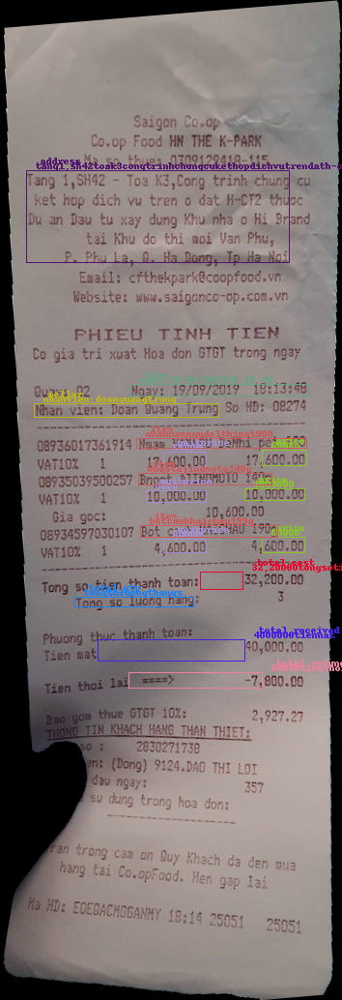

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013niqeq.jpg
- Function run_saliency run in 0.1158812's
- Function make_warp_img run in 0.00468588's
- Function run_ocr run in 1.51795912's
- Function get_group_text_line run in 0.05372643's
thoi gian layout 0.10224103927612305
ngayban:14/0820200820
08
##2
1080
58
tongtienphai
60582
0271085858-43581
##n
tienkhachina0066
tieniralai
nvbh:09020497
[CLS]vil%qnh530tranphuso10tranphupcamthuy
tpcamphaquangninh
60582
taojazznewsizenho15069.000/kg


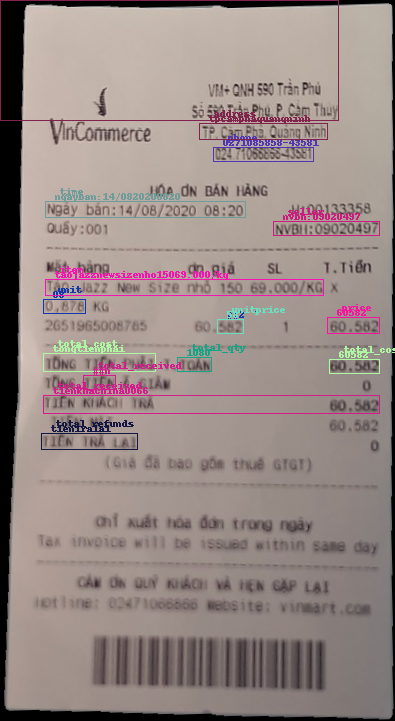

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013pqnzb.jpg
- Function run_saliency run in 0.13027787's
- Function make_warp_img run in 0.0054667's
- Function run_ocr run in 2.05695605's
- Function get_group_text_line run in 0.0617764's
thoi gian layout 0.0932779312133789
ngay:12/08/2020-12:10
tongso:
13
13,0000
8,000
10000
101
##0
tongcong1051000
tienkhachtra:
10500
thungan:bh3
chosuiphuthigialam
,0000
32000
20,000
10,000
##00
30,00030,000
bvsdianahangngay12knt
bvslibera8pnt
dxsunsilkdaynt
dgsunsilkdaynt
nrcsunlightchanhtui141nt


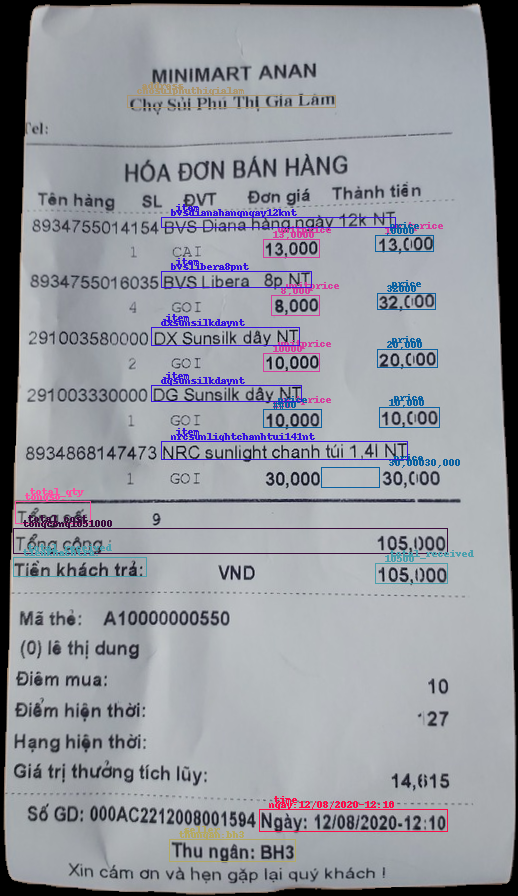

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014cftxo.jpg
- Function run_saliency run in 0.13966155's
- Function make_warp_img run in 0.00571847's
- Function run_ocr run in 1.98306918's
- Function get_group_text_line run in 0.10915089's
thoi gian layout 0.09776663780212402
ngayban090820202030
43000
37000
18000
16700
114700tongtienphait.ttoan
0247106e366-151561
hotine:02471066866
114700tienkhachtra
385300tientralai
nvbh:09025438
[CLS]vm4qnhto7khuminhtienatokhuminhtienacambinhtpcamphaqnh
43000
37000
18000
16700
laurierbvssmbaove1mm225cm10mieng
ipekbongtaytrang120m
laurierbvsth.ngaysactivefitk.lhuong20m
baominhkeodoi150g/120g


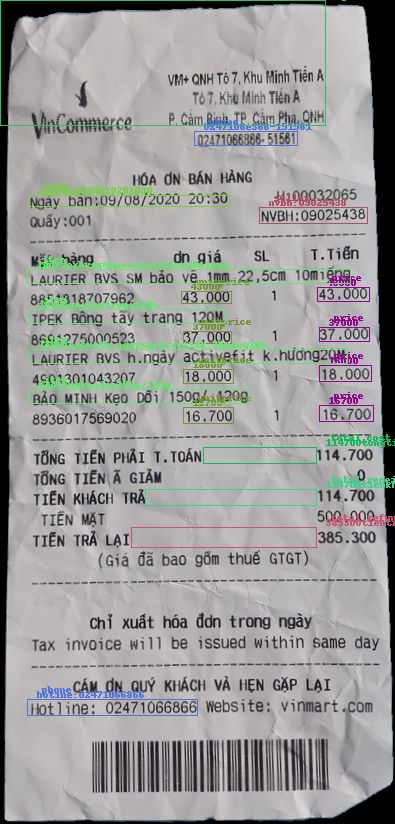

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014obtof.jpg
- Function run_saliency run in 0.10293055's
- Function make_warp_img run in 0.00507784's
- Function run_ocr run in 1.66053391's
- Function get_group_text_line run in 0.04943848's
thoi gian layout 0.08940315246582031
ngayban:13708/202015:559
139000
tongtienphaitoan139000
0247100031851581
hotline:02471066866
tienkhachtra13900
tientralai61000
nvbh:09025438
[CLS]vm-onhto7.khulaminh1latiecat67khuminhtina
cambnhtpcamlphioh
139000
vmhomedugap90nbandstronm1(den)


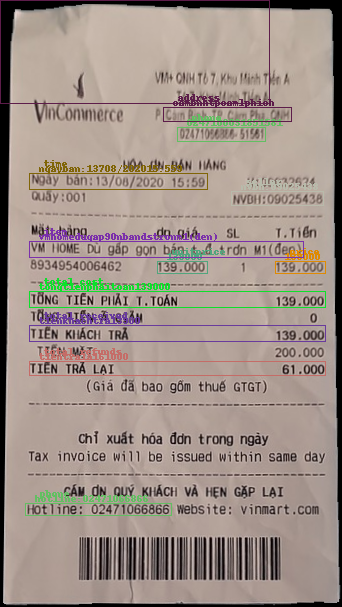

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014jfoxg.jpg
- Function run_saliency run in 0.12046599's
- Function make_warp_img run in 0.00522256's
- Function run_ocr run in 1.66592884's
- Function get_group_text_line run in 0.04209304's
thoi gian layout 0.09929490089416504
051020201316
0510.20201317
29000
29000
tongtien(vat):58000
tel:0888212505
fkhachtra:5800c
[SEP]
trakhach:
thungan:administrators
[CLS]
244/23ahuynhvanbanh,p.11,q.pn
29000
29000
cafenau
cafenau


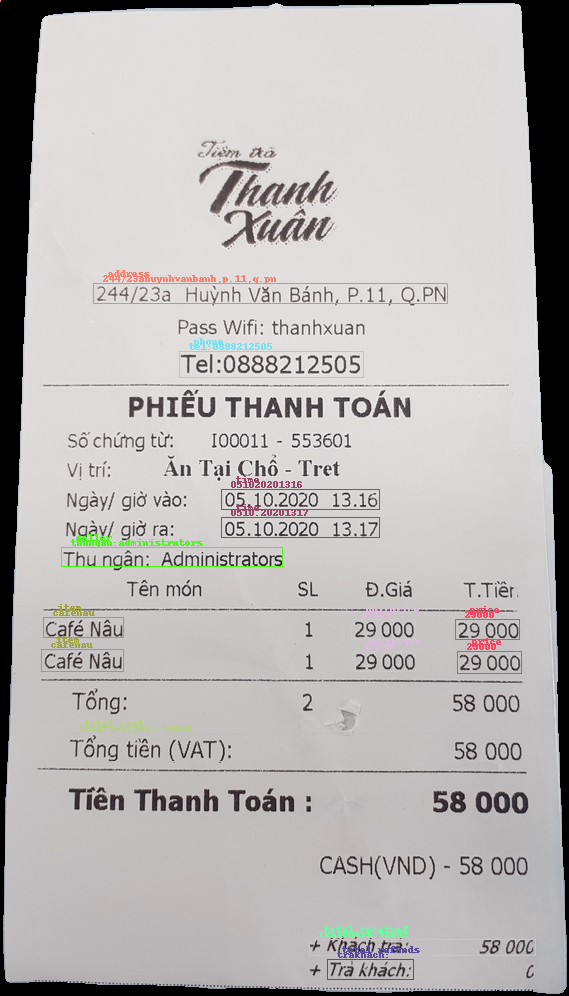

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014bqwna.jpg
- Function run_saliency run in 0.116606's
- Function make_warp_img run in 0.00548029's
- Function run_ocr run in 1.1184938's
- Function get_group_text_line run in 0.05377436's
thoi gian layout 0.12087678909301758
thoiagian:"114:14:5314/08/2020
[CLS]
121500
24000
10500
101500
8700800
tongsothanhtoan:84500d
dt0333863328fax0333863328
dc212duongtranphu-campha
121500d
24000d
10500d
210004
87004
78004
belamquenvoi
5-luyentaplam
vbttoan3/2
vbttoan3/1
vbttiengviet3/1
vbttiengviet3/2
[SEP]


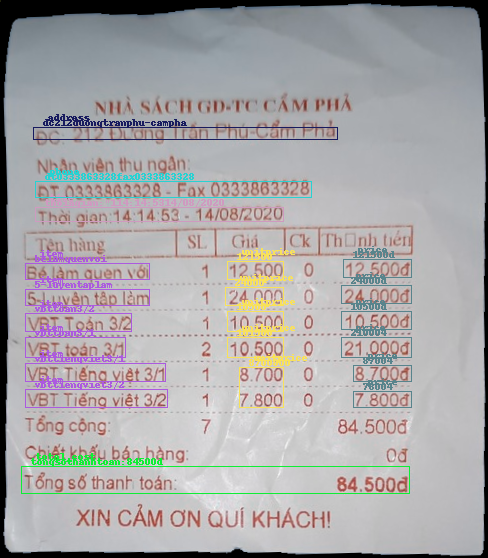

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014imncc.jpg
- Function run_saliency run in 0.10086274's
- Function make_warp_img run in 0.0075984's
- Function run_ocr run in 1.06103897's
- Function get_group_text_line run in 0.02500749's
thoi gian layout 0.08648085594177246
[CLS]
thoi19gian:01.110.2020609.01
35000
10000
thanhtoan100000
(vua)
tienkhachdua51000
tienthua
thungancashi
403phanhuyich,p.14,q.govap
35000
20000
caiphesuada
banhmiquecay


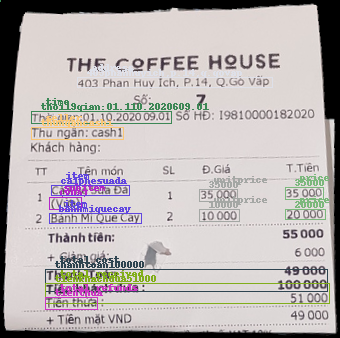

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013lbslf.jpg
- Function run_saliency run in 0.1412456's
- Function make_warp_img run in 0.0057826's
- Function run_ocr run in 1.83857822's
- Function get_group_text_line run in 0.04793's
thoi gian layout 0.08885002136230469
ngay:16/08/2020-18:36
[CLS]
11tongso:
8500
5,000
7,500
12000
5,000
103,000tongcong
103000tienkhachtra:
thungan:bh5
chosuiphuthigialam
8500
5,0000
7,500
72000
10,000
thuoclathanglongmemnt
batluakhono
nuoctanglucswakerupnt
thucuongnangluongcafenno
keocaosudmthanhnt


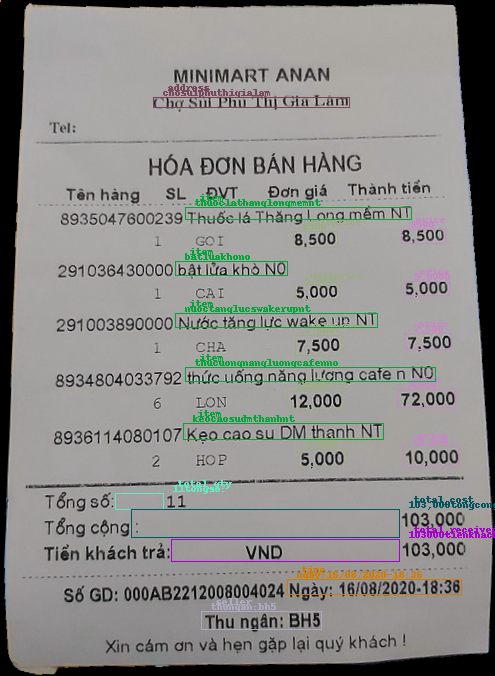

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013jiksh.jpg
- Function run_saliency run in 0.13391399's
- Function make_warp_img run in 0.00523329's
- Function run_ocr run in 0.33744383's
- Function get_group_text_line run in 0.0859108's
thoi gian layout 0.08856749534606934
53zz573
55
53
f


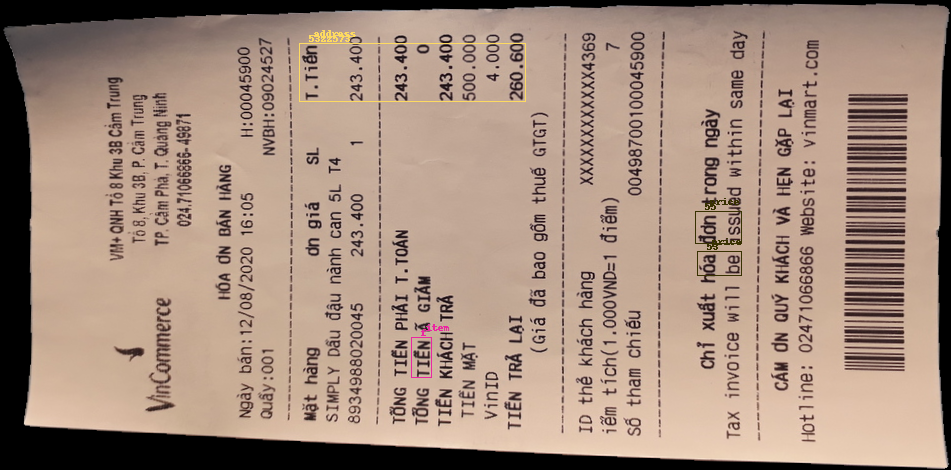

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014elolx.jpg
- Function run_saliency run in 0.12908101's
- Function make_warp_img run in 0.0080452's
- Function run_ocr run in 1.55747008's
- Function get_group_text_line run in 0.03800178's
thoi gian layout 0.09784841537475586
ngay:11/08/2020-18:58
tongso
18000
tongcong18000
tienkhachtra:
18000
thungan:bh5
chosuiphuthigialam
182000
tuongotvichi21nt


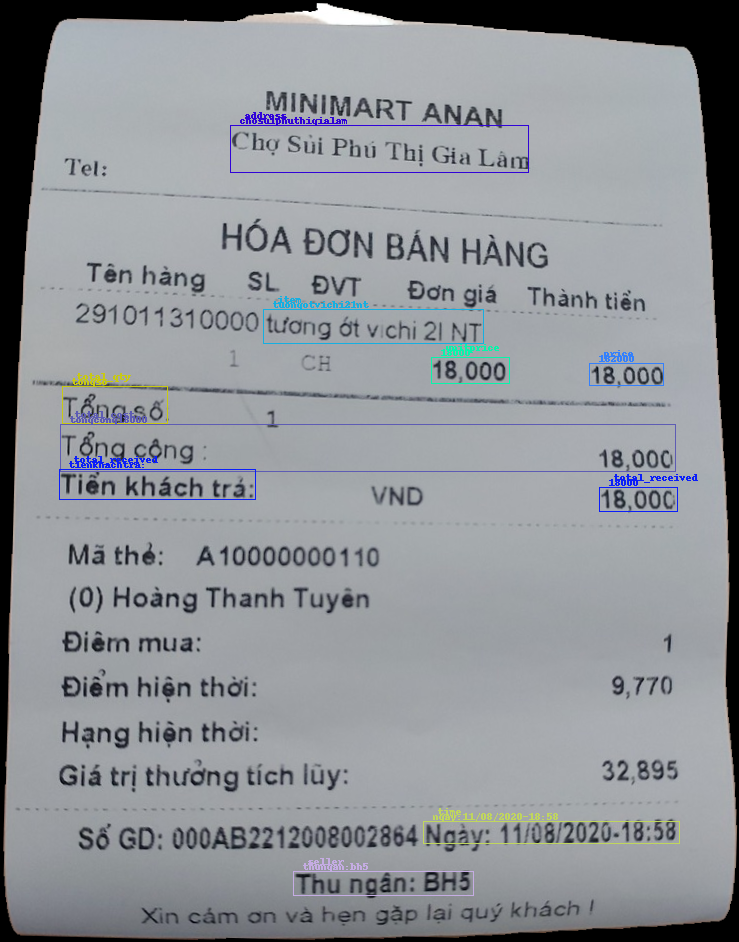

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014qcume.jpg
- Function run_saliency run in 0.09625983's
- Function make_warp_img run in 0.0045855's
- Function run_ocr run in 1.25752306's
- Function get_group_text_line run in 0.02559733's
thoi gian layout 0.12663865089416504
[CLS]
thoi19:gian:19:50:3314/08/2020
201000
tongsothanhtoan:201000d
dt0333863328fax0333863328
dc212duongtranphu-campha
200004
bitlmatnuoc


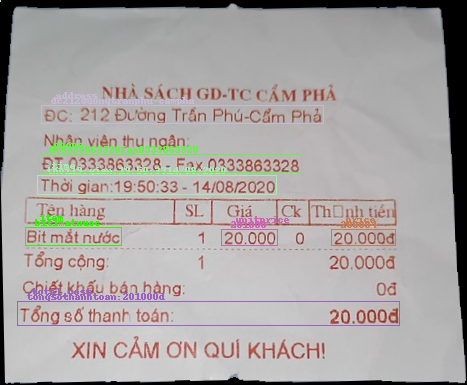

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014kplqb.jpg
- Function run_saliency run in 0.1104393's
- Function make_warp_img run in 0.00437307's
- Function run_ocr run in 1.17915225's
- Function get_group_text_line run in 0.0382514's
thoi gian layout 0.11919260025024414
thoiagianic09:13:1615/08/2020
95000
9000
221000
tongsothanhtoan:126loood
[CLS]
dt0333363328fax0333863328
dc:212duongtranphu--campha
95000a
9000d
22000d
bangaphs5210
vbttoan2/1
tay1198?1166c


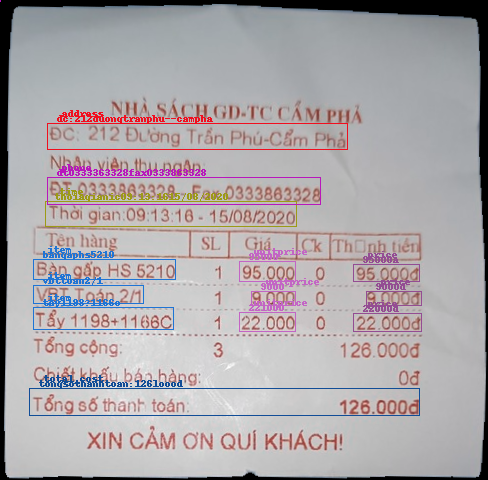

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014lxhnj.jpg
- Function run_saliency run in 0.10402703's
- Function make_warp_img run in 0.00482225's
- Function run_ocr run in 0.92530632's
- Function get_group_text_line run in 0.02152014's
thoi gian layout 0.08902835845947266
thoigan
13/08/2020
tong
000
tong08thanhtoan:14loood
[CLS]
dt0333803326far0333003328
oc212duongtranphucamphb
0004
aomuagiay


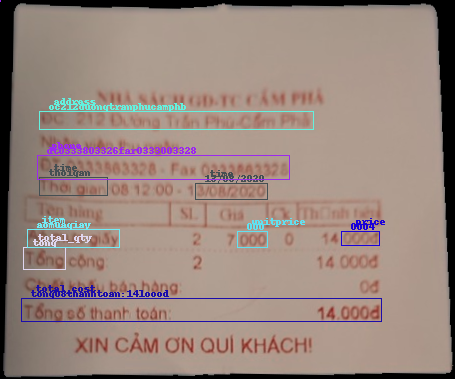

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014knafb.jpg
- Function run_saliency run in 0.09847999's
- Function make_warp_img run in 0.00506067's
- Function run_ocr run in 1.06429338's
- Function get_group_text_line run in 0.03126717's
thoi gian layout 0.12544751167297363
thoiagianny10095515/08/2020
ongcong2
43000
42000
tongsothanhtoan:851000d
[CLS]
dt0333863328fax0333863326
dc212duuongtranphuampha
430004
42000d
btanh
tienganh4/1


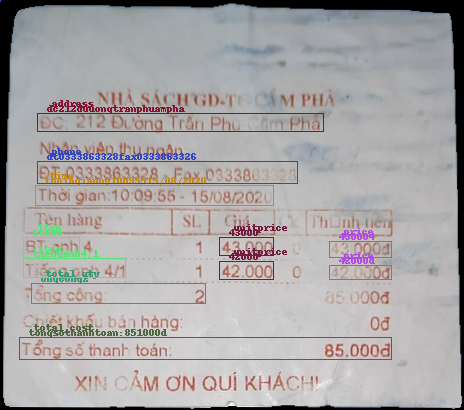

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013mzyyu.jpg
- Function run_saliency run in 0.15559411's
- Function make_warp_img run in 0.00611973's
- Function run_ocr run in 1.9608674's
- Function get_group_text_line run in 0.09275699's
thoi gian layout 0.09285259246826172
ngay:19/09/201918:14:44
tongsoluongchanga
2520000
25,200l00tongsotienthanhtoan:
nhanvien:doanquangtrung
toak3congtrinhchungcutang1,sh42kethopdichvutrendath-ct2thuocduandautuxaydungkhunhahibrandtaikhudothinoivanphupphula,0hadong,tphanoi
25,20000
chocokinderjoytrunghong


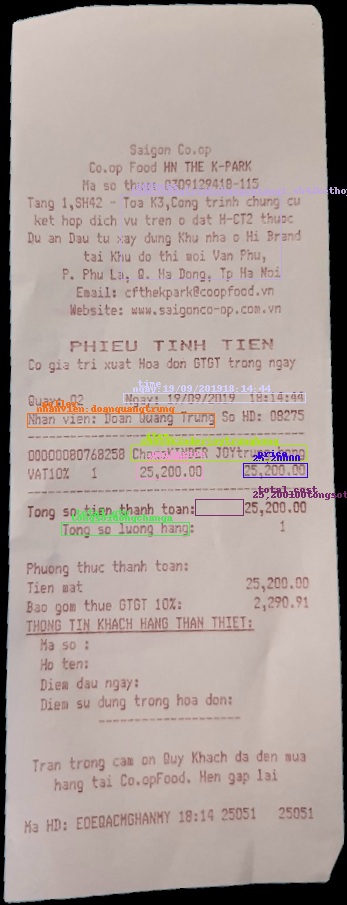

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014zsypc.jpg
- Function run_saliency run in 0.12963367's
- Function make_warp_img run in 0.00553179's
- Function run_ocr run in 2.014112's
- Function get_group_text_line run in 0.08608031's
thoi gian layout 0.09225177764892578
ngay:11/08/2020-21s29
5
tongso:13
23000
53
53,
13
13,
10000
,250
35,000
176,0000tongtien
500,000tienkhachtra:
3241000tientralaivnd
thungan:bh3
chosuiphuthigialam
23000
,4000
,000
10,000
42000
35,000
nuoctaytoiletgift700mlnt
thuocoxitmuoiajumbo600mlnt
keokopikoden150gnt
keoalpenliebegoii2ognt
suachuaduongvnm100gnt
banhisobisyukint


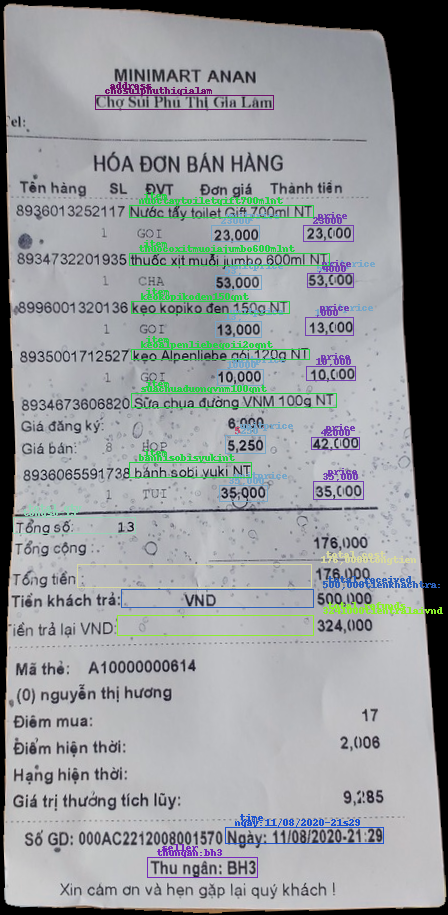

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014ptuuq.jpg
- Function run_saliency run in 0.11038804's
- Function make_warp_img run in 0.00537038's
- Function run_ocr run in 3.57209802's
- Function get_group_text_line run in 0.07351851's
thoi gian layout 0.1309971809387207
ngayban:113/08/3202017:37
8000
tongtienphait.t
t
024710663644301
hotline:02471066866
.
.t.t.t.t.t.t.t.
.
.
.
.
.
.
.
.
.
.
.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.t.
tienkhachtra24000
tientralai
[CLS]
nvb11:09024146
t.t.t.t.t.t.t.t.t.t.t.t.t
t
t
t
t
t
t
t
t
t
t
t.t
vimeonh1080-1082tranphuso1060-1082duongtranphu
tpcampnaquangnah
24000
banhcomdauxanhtranbaominh85g


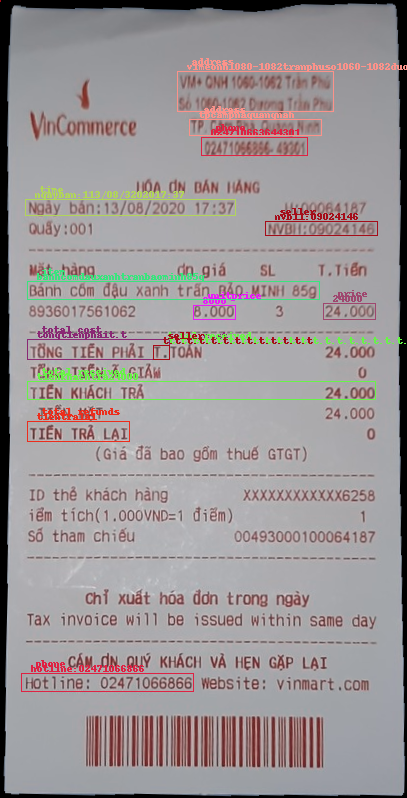

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013vnlnm.jpg
- Function run_saliency run in 0.11004734's
- Function make_warp_img run in 0.00492263's
- Function run_ocr run in 1.03818607's
- Function get_group_text_line run in 0.02591395's
thoi gian layout 0.09757661819458008
ngay:26062020
22000
khachphaitra44000
[CLS]
0945984733
tienkhachdura44200
0tralai
248cobigiaamhanoi
44000
scwinamilkcoduong100g


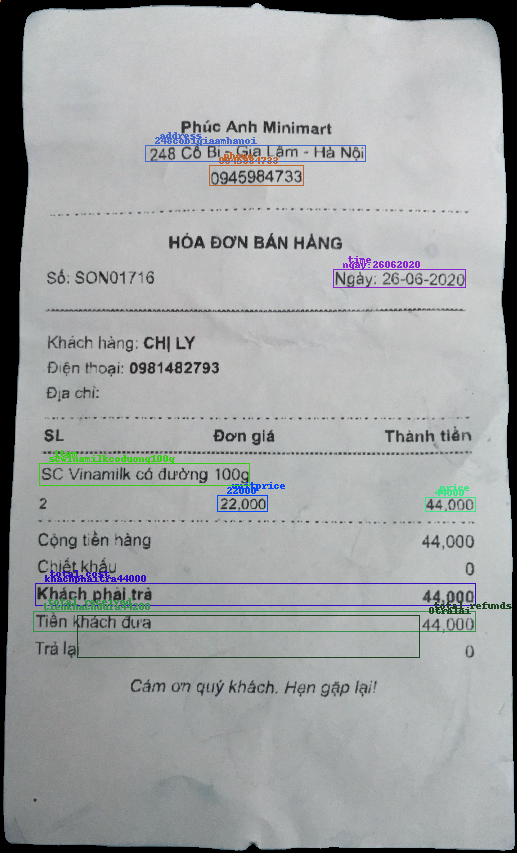

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014lrken.jpg
- Function run_saliency run in 0.0980525's
- Function make_warp_img run in 0.00507665's
- Function run_ocr run in 1.96301675's
- Function get_group_text_line run in 0.06449056's
thoi gian layout 0.12455391883850098
[CLS]
viec:17:3022:00
ngay:10/08/2020-111
.25
07
tongso:230
47000
63000
tongcong(
t):125,220
tel:20203.3731199
tienkhachtra:
126,0000
tientralaivnd700
thungan:ngohaz
so5camtaycamphaon
57;810
67410
duihoiganhapkhaudl(ma121)nt
changanhapkhaudl(ma38)nt


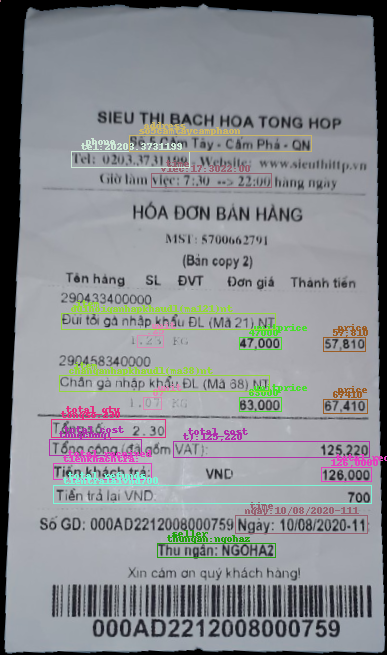

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014xjfxx.jpg
- Function run_saliency run in 0.10284233's
- Function make_warp_img run in 0.0047574's
- Function run_ocr run in 1.5050571's
- Function get_group_text_line run in 0.0107789's
thoi gian layout 0.08697199821472168
thoiogian:08:42ngay814/08/2020
024071066866-43581
nvbh:09020497tenanv:4358pos1
[SEP]
[CLS]vm4qnh590tranlphuso590tranphupcamthuy
tpcamphaquangninh


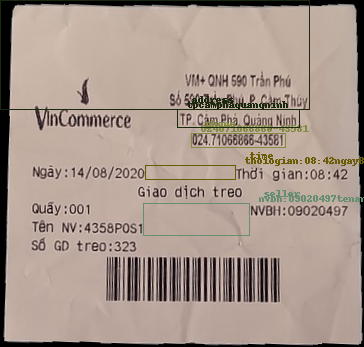

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013eekwk.jpg
- Function run_saliency run in 0.15683722's
- Function make_warp_img run in 0.00631428's
- Function run_ocr run in 0.42671204's
- Function get_group_text_line run in 0.12619543's
thoi gian layout 0.09847664833068848


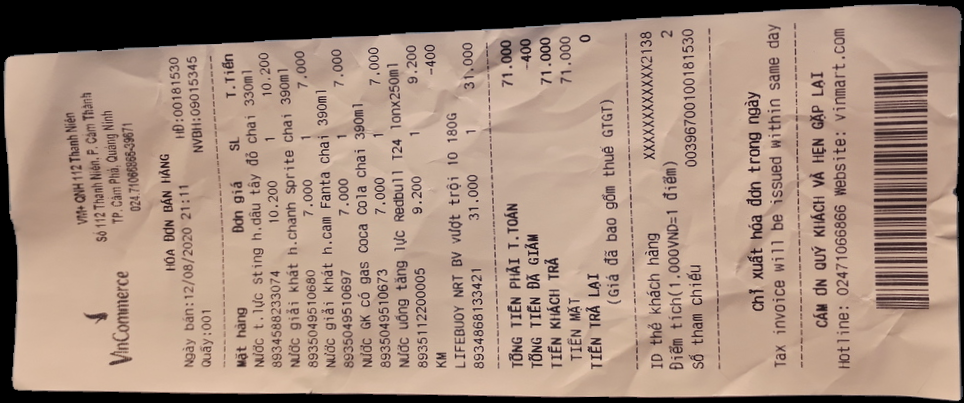

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013hfxkr.jpg
- Function run_saliency run in 0.13416934's
- Function make_warp_img run in 0.00927114's
- Function run_ocr run in 1.67451119's
- Function get_group_text_line run in 0.09077287's
thoi gian layout 0.09172725677490234
ngay:16/08/2020-16:22
24
10
tongso:55
7,5500
5,500
3,334
8,300
11,000
tongtien311,016
tienkhachtra:311,01
thungan:bh5
chosuiphuthigialam
601000
55,0000
80,016
83,000
33,0000
scumensongprob30mlnt
kemtrangtiensauriengxnt
nuoclavie500mlnt
thuoclathanglongmemnt
thuoclathangnt


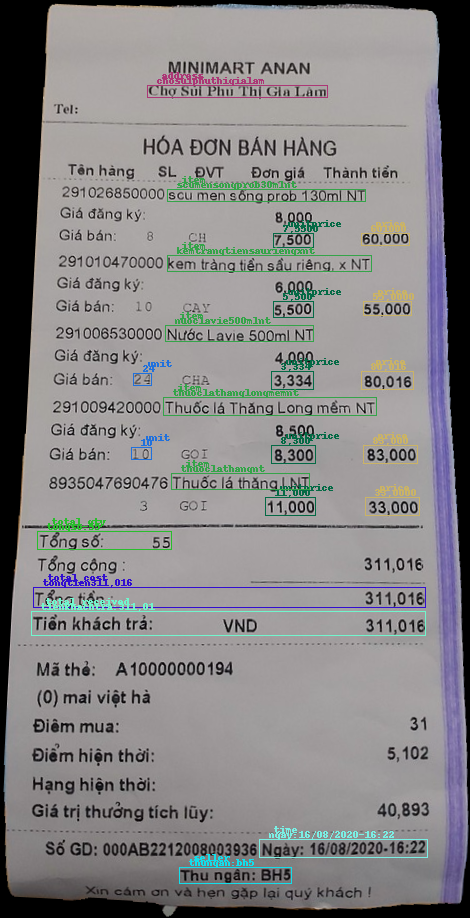

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014auskb.jpg
- Function run_saliency run in 0.11109638's
- Function make_warp_img run in 0.00425482's
- Function run_ocr run in 1.65875125's
- Function get_group_text_line run in 0.02789044's
thoi gian layout 0.0938255786895752
diaonidaithi11wom
[CLS]
(30:11
21:37:16ngay:01/6/00
tongcongund61400


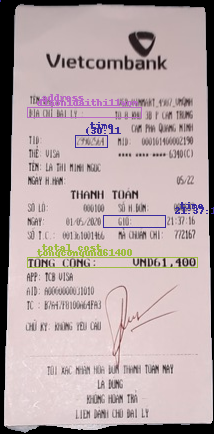

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014xkqax.jpg
- Function run_saliency run in 0.12018728's
- Function make_warp_img run in 0.00793076's
- Function run_ocr run in 1.52668858's
- Function get_group_text_line run in 0.04651093's
thoi gian layout 0.09156918525695801
ngayban:14/08/120200903
49500
tongtienphait.toan49.5500
[CLS]
0241710ssess-19571
hotcline:02471066866web
[SEP]
tienkhachtra49500
tientralai
nvbh:o09015347
vin
1112thanhhaso112thanhhien,pcamthinh
tpcamphaquangilm
49500
cpthitheoxay300g


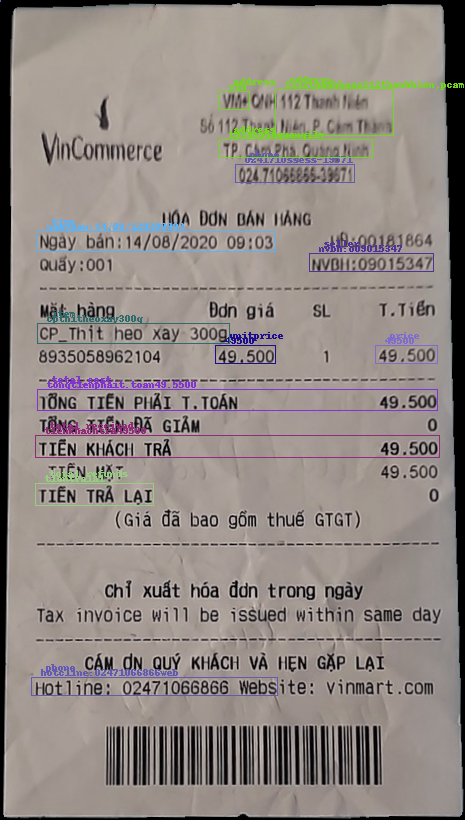

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013bvmvl.jpg
- Function run_saliency run in 0.12179685's
- Function make_warp_img run in 0.00565839's
- Function run_ocr run in 1.65221977's
- Function get_group_text_line run in 0.06603408's
thoi gian layout 0.09857964515686035
ngay:16/08/2020-21818
48
1
tongso:50
3
227040tongtien
227,040
tienkhachtra:
thungan:bh3
chosuiphuthigialam
185,0040
22,00022,000
20,00020,0000
,
##0
suakunacamadau1110mlnt
suadacongthodoxanhvnnt
numvupigeontrangnt


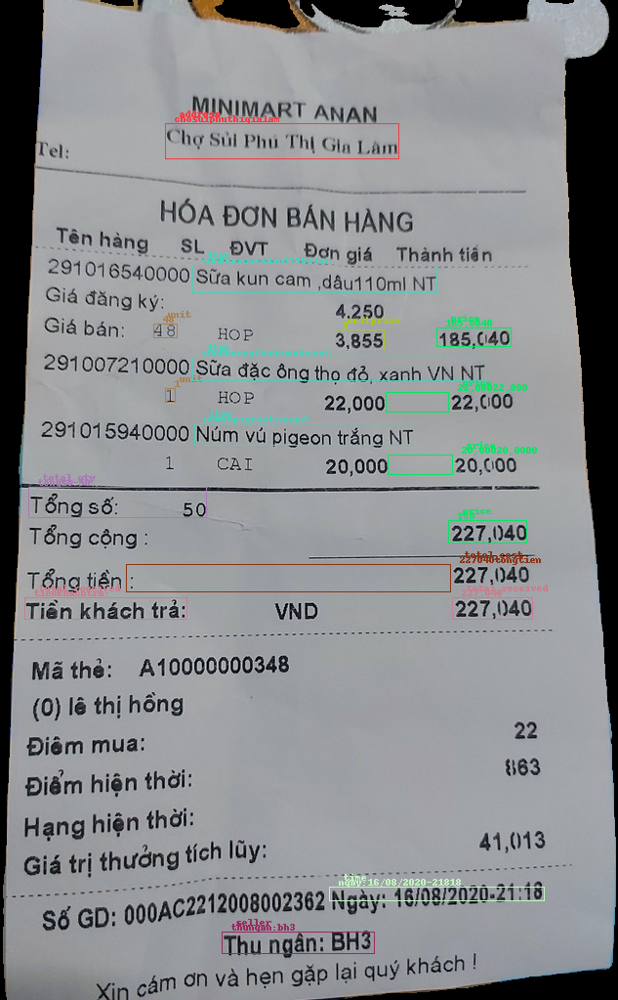

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014lwhgn.jpg
- Function run_saliency run in 0.1436801's
- Function make_warp_img run in 0.00629783's
- Function run_ocr run in 2.27984595's
- Function get_group_text_line run in 0.07192421's
thoi gian layout 0.09197831153869629
ngay:15/08/2020-18.142
12tongso:
30000
39000
16,000
6,5500
33,0000
6
tongtien
200,0000
tienkhachtra:
31,000tientralai
ngan:bh3hu
chosuiphuthigia1.am
30000
39000
16000
26,0000
33,000
25,000
suavnmduongitduong1lnt
trasuablendydaumatchano
botlamthachnt
suachuanhadam100gnt
suadaccghltui560gno
suakuncamdau180mlnt


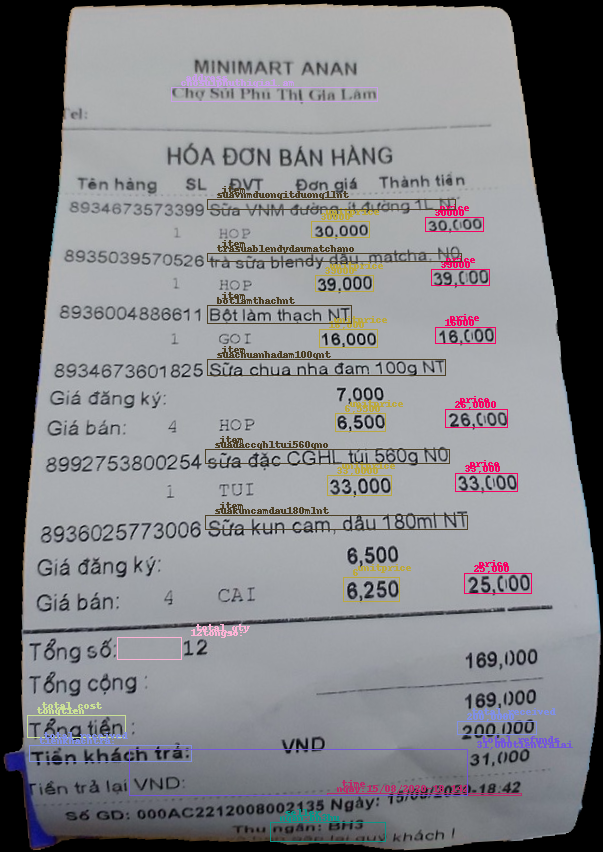

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014dnwoz.jpg
- Function run_saliency run in 0.12892151's
- Function make_warp_img run in 0.00490952's
- Function run_ocr run in 1.16811728's
- Function get_group_text_line run in 0.02551222's
thoi gian layout 0.09109950065612793
thoi1gian:081120200909
38000
thanhtien:3800038000thanhtoan
(lon)
tienkhachdua50000
tienthua12000
thungan:cashi
[CLS]
403phanhuyich,p.14,q.govap
38000
caphesuada


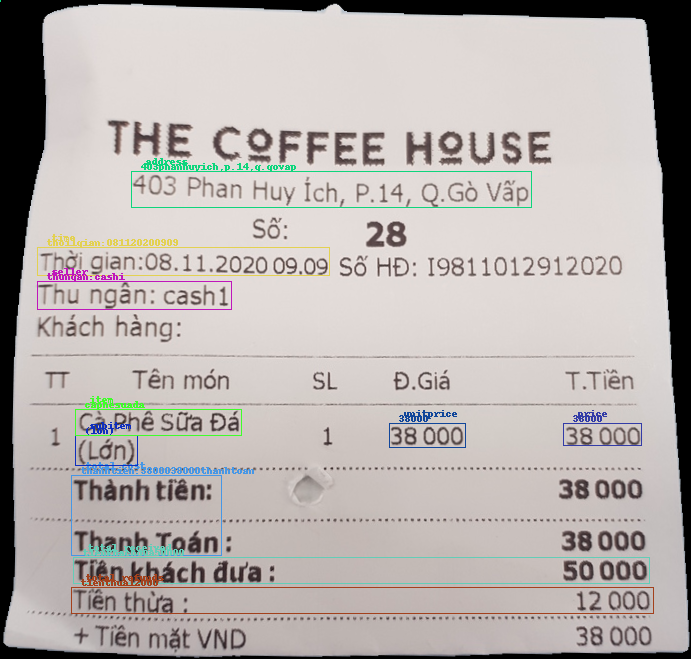

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014sydpm.jpg
- Function run_saliency run in 0.10520864's
- Function make_warp_img run in 0.00560713's
- Function run_ocr run in 1.16532111's
- Function get_group_text_line run in 0.06281519's
thoi gian layout 0.12475419044494629
ngay:14-082020
[CLS]
12
11,000
2,000
21000
32l000
32000
khachphaltra
0945984733
224,1000tionkhachmua
250000tralai260
248cobi-gialamhanoi
1321000
12000
16000
32l000
321
bohucthai250ml
keodooyupibugerbg
keodeoyupifrankfuter8g
thcoduong11
thitduong1l


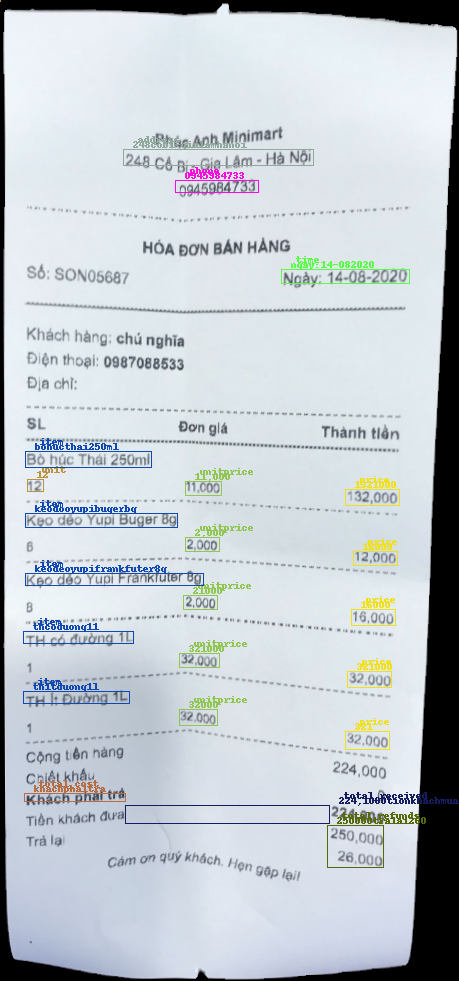

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014elcju.jpg
- Function run_saliency run in 0.13035297's
- Function make_warp_img run in 0.00626874's
- Function run_ocr run in 1.36621976's
- Function get_group_text_line run in 0.07030129's
thoi gian layout 0.09198403358459473
ngayban:14/08/2202015:33
184500
184500tongtienphaittoan
[CLS]
024171066866-115890
hotine:024171066866
184500tienkhachtra
15500tientralai
nvbh:(09017432
vmphamngocthach
so2phamngocthach
trungtuqdongdatphanoi
184500
caphetancaocapfamilytchibolo200g


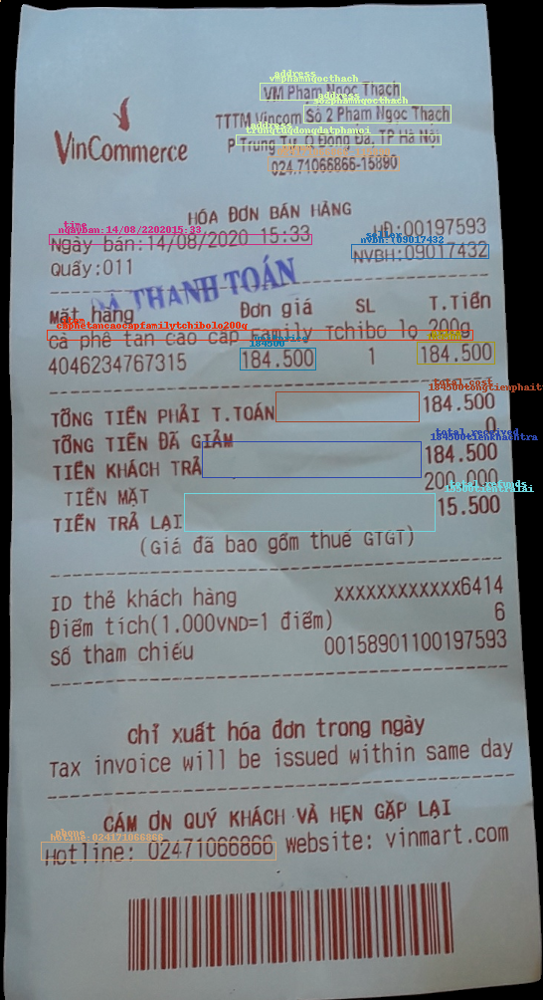

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013qlpau.jpg
- Function run_saliency run in 0.11379695's
- Function make_warp_img run in 0.00517678's
- Function run_ocr run in 1.80590534's
- Function get_group_text_line run in 0.05786109's
thoi gian layout 0.09525442123413086
ngayban:11/08/72020201658
20000
tongtienphaitoan20000
0241710ssess-1981
hotine:02471066866
tienkhachtra20000
tientralai
anvbiii:o09015348
[CLS]villech112thanhhienso112thanhkincamthanh
campha,quinglaninh
20000
wallchocoluv135mlt20


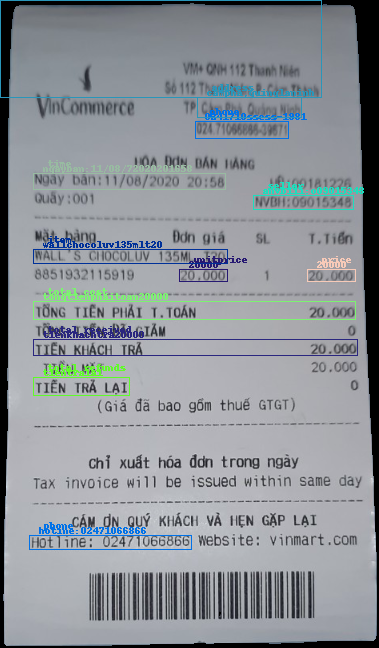

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014tzbvy.jpg
- Function run_saliency run in 0.13167238's
- Function make_warp_img run in 0.00583553's
- Function run_ocr run in 1.25930524's
- Function get_group_text_line run in 0.06625676's
thoi gian layout 0.09179949760437012
1)9.36
ngay:14.07202.)06
giovao:11.5112.41
1,00
4
00
4,00
3,00
,
thanhtie
hotline:04858618738
tra...at
tiennthanhtoan5.4000tien
cs12125tuetinhhaiearung-hanoics25dquargtrunghoankenhavoi
189xadandingda-fanoi
giayha
5con
coc
220
banhraniittrasamdua


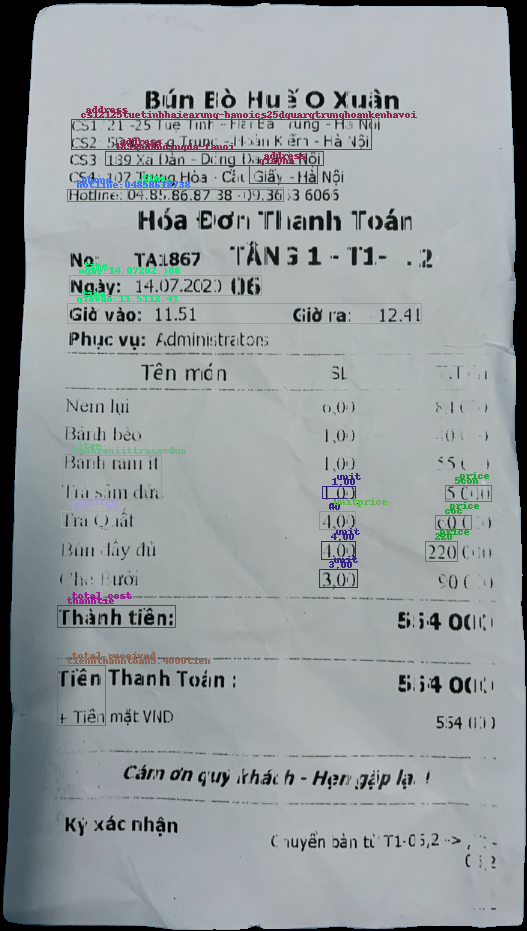

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014zkhdi.jpg
- Function run_saliency run in 0.14117455's
- Function make_warp_img run in 0.00656867's
- Function run_ocr run in 1.92638659's
- Function get_group_text_line run in 0.08190727's
thoi gian layout 0.09533977508544922
34.43
ngay:11/08/2020-2120
tongso:19
16000
110,000
6,0000
12000
25000
30,000
tsongcong243000
tienkhachtra:
243,
thungan:bh3
chosuiphu1thigialam
96,000
50,000
501000
12000
25,000
301000
bvskaomongcanhnt
misomachibohamnaugoi10no
miomachisuon80gnt
banhmisandwichbaongoc2no
hopthitlonxayhl170gnt
patethitheovissannq


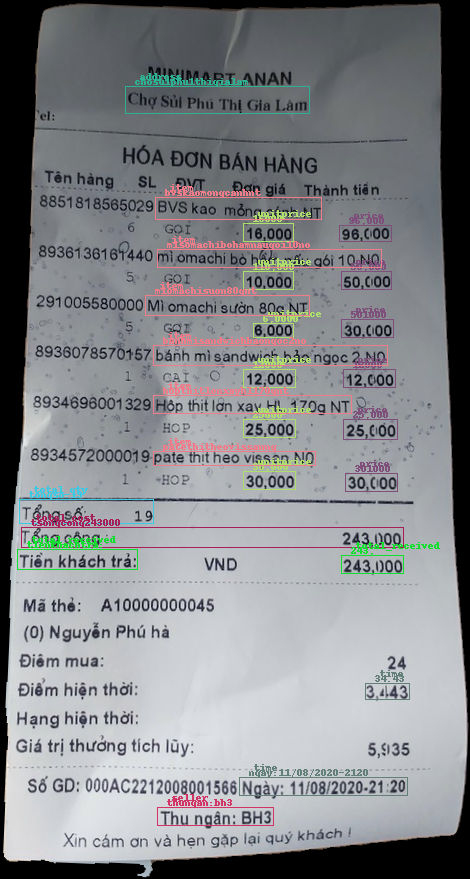

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013aqosh.jpg
- Function run_saliency run in 0.13978362's
- Function make_warp_img run in 0.00496483's
- Function run_ocr run in 1.88937902's
- Function get_group_text_line run in 0.0447998's
thoi gian layout 0.09133386611938477
ngayban:10/08202010150
800
7800tongtienphaittoan
12417106sess-43831
hotline:02471066866website:
800tienkhachtra
2.200tientralai
nvbh:009020166
[CLS]villeonh86tranlphuso86laduongtranphupcamtay
tpocamiphaquangninh
60800
wmgoodbotchiengionsangia1509t


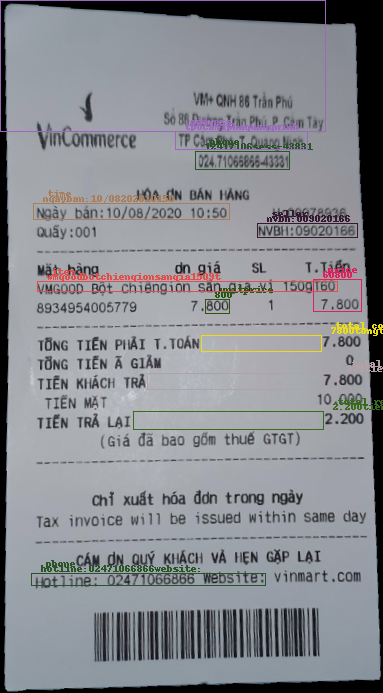

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014evbnu.jpg
- Function run_saliency run in 0.13426566's
- Function make_warp_img run in 0.00566459's
- Function run_ocr run in 1.19808507's
- Function get_group_text_line run in 0.02224684's
thoi gian layout 0.12916016578674316
ngay:11-08-2020
22,0,000
22,000congtienhang
086932249602438765210
[CLS]
thonphuthuy.xaphuthi.huyengialam.tphanoi
22000
hatnemneptune380g


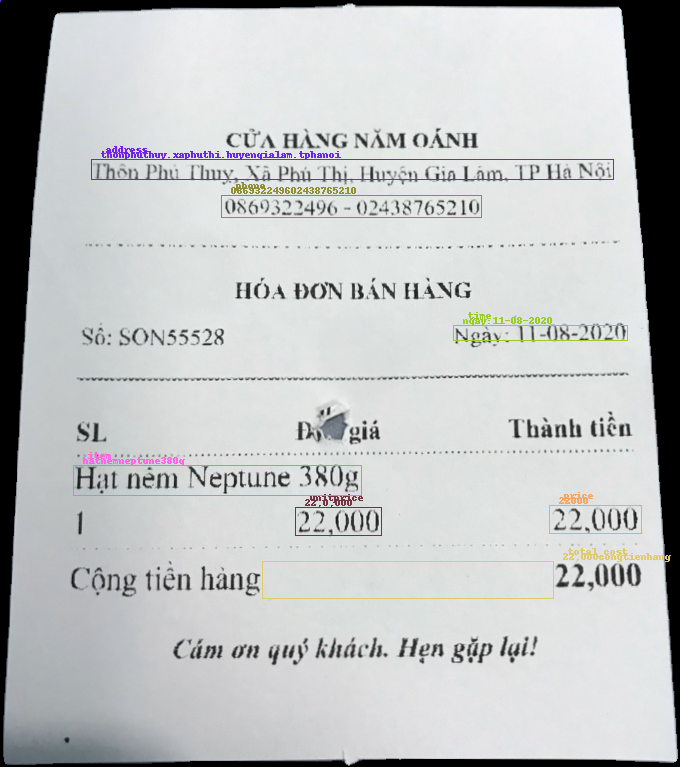

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014uilrh.jpg
- Function run_saliency run in 0.12464976's
- Function make_warp_img run in 0.00806308's
- Function run_ocr run in 0.8643136's
- Function get_group_text_line run in 0.02658105's
thoi gian layout 0.11304783821105957
thoigian:09:420911/08/2020
50000
tongsothanhtoan:50000d
[CLS]
dt0333863328fax0333863328
dc:212duongtranphu-campha
500004
tuibut20106


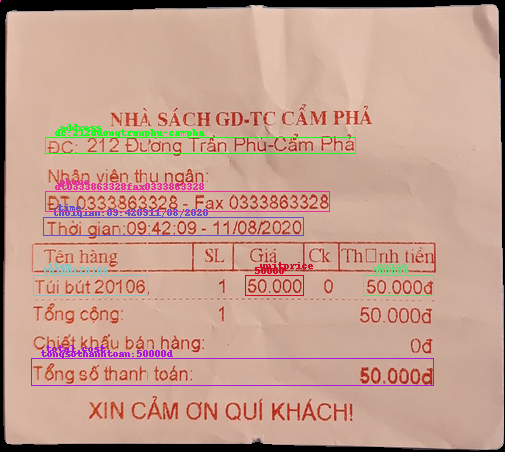

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014dypib.jpg
- Function run_saliency run in 0.10318184's
- Function make_warp_img run in 0.00888205's
- Function run_ocr run in 1.20627785's
- Function get_group_text_line run in 0.03740048's
thoi gian layout 0.12662625312805176
thoiagianz20033404/08/2020
6000
101000
271000
43looodtongsothanhtoan:
[CLS]
dt0333863328fax0333863328
dc212duongtranphu-campha
620004
10toood
27000d
hinhhoc12
vo5oly48tr0584


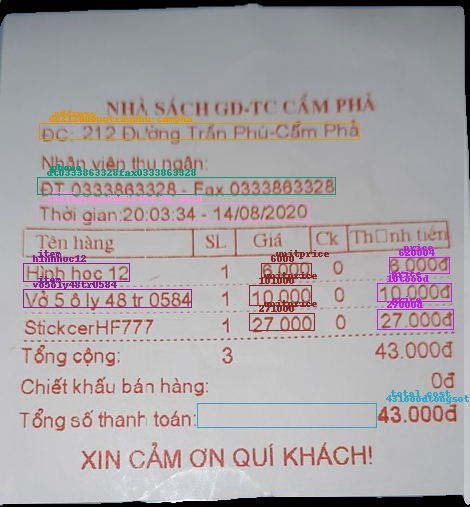

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014bwelu.jpg
- Function run_saliency run in 0.13939595's
- Function make_warp_img run in 0.00635266's
- Function run_ocr run in 1.77365112's
- Function get_group_text_line run in 0.06610847's
thoi gian layout 0.09088730812072754
ngayban:14/08/202016:05
5900
34000
tongtienphait.t.toan33.800
0240.71066866-44561
hot1ine:02471066866website
tienkhachtra33.
tientralai66200
nvbh:09021213
[CLS]vm%qnhduankdclanbiencoc6dakhudclbcoc6p.camson
tp.camphat.quangninh
11.800
34.000
kemmerinokoolchanhmuoicay50gt54
jomibongtaytrang120m


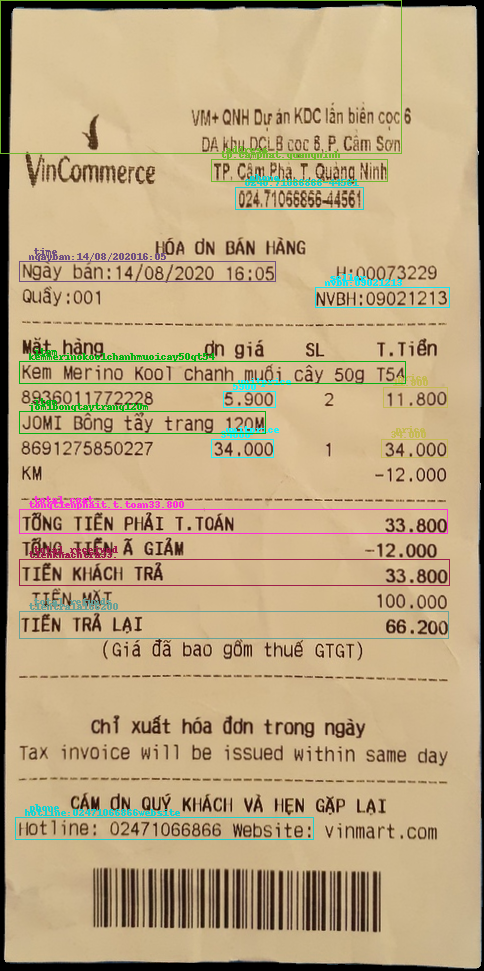

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014bjahl.jpg
- Function run_saliency run in 0.12300014's
- Function make_warp_img run in 0.00496435's
- Function run_ocr run in 1.98144627's
- Function get_group_text_line run in 0.07151914's
thoi gian layout 0.12598681449890137
ngaybans10/08/202015:19
000
000
tongtienphaittoan
024171066866-27971
hotlline:02471066866
tienkhachtra6000
tientralai
envbh:o09007033
[CLS]vmttttmchosuiso42phosuixaphuthi
huyendgialamhanoi
40000
20000
thucuongkunsocolaluamach110ml
suachuauonglifkunthuongcam10ml


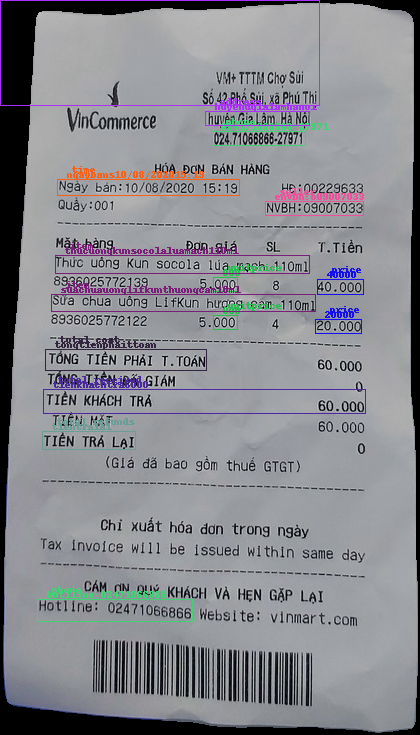

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014bpeci.jpg
- Function run_saliency run in 0.10550618's
- Function make_warp_img run in 0.00507736's
- Function run_ocr run in 2.01852179's
- Function get_group_text_line run in 0.03575444's
thoi gian layout 0.12946605682373047
##di
06:23:041207/820
tongcung:
d402766


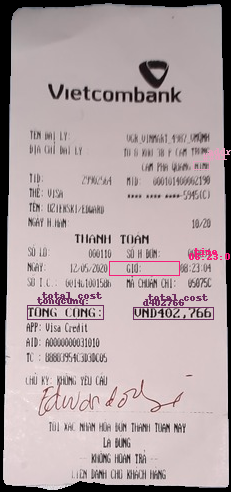

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013xaojq.jpg
- Function run_saliency run in 0.12460566's
- Function make_warp_img run in 0.00628591's
- Function run_ocr run in 0.84631133's
- Function get_group_text_line run in 0.02519894's
thoi gian layout 0.12832188606262207
thoigian:60848:1213/08/2020
5000
30000dtongsothanhtoan:
[CLS]
dt0333863328fax0333863328
dc212duongtranphu-campha
30000d
30000d
vpploai5k


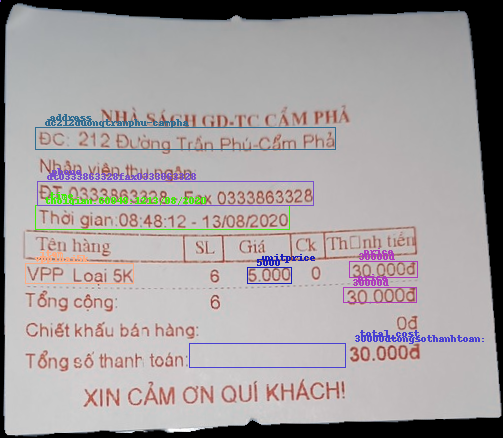

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013cuilp.jpg
- Function run_saliency run in 0.13782573's
- Function make_warp_img run in 0.00581741's
- Function run_ocr run in 1.41244459's
- Function get_group_text_line run in 0.05764651's
thoi gian layout 0.0985112190246582
49.
60000
tongtienphait.toan81.715
hotine:02471066866
tienkhachtra81.715
tientralai20285
ovmnktaorubystarnzl
190
120
pgsize
49613
898
60000
##8
cpnemthitdacbiet500g


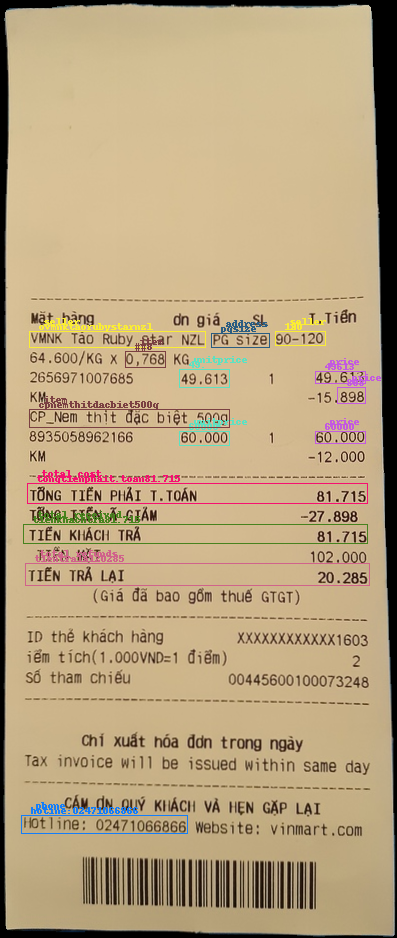

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014fhbos.jpg
- Function run_saliency run in 0.13097787's
- Function make_warp_img run in 0.00598025's
- Function run_ocr run in 2.0316298's
- Function get_group_text_line run in 0.07595825's
thoi gian layout 0.13116240501403809
ngayban:10/08/2202013:53
900
tongtienphait.ttoan47900
[CLS]
0240710ssess-39571
hotine:02471066866website:
[SEP]
tienkhachtra900
tientralai152100
nvbh:09015348
vinhtronh1127thanhnienso112thanhniencamthanh
camiphaquangninh
47900
bibigokinchicaithaongo500g


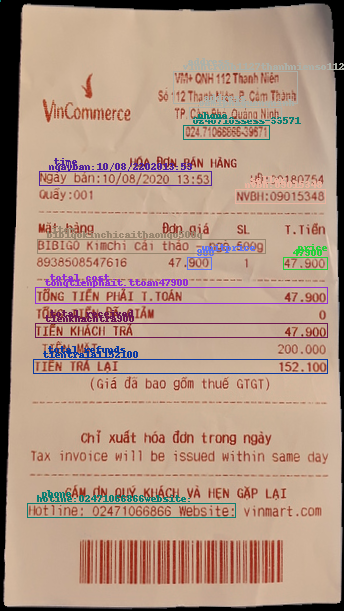

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014vrbsr.jpg
- Function run_saliency run in 0.15566587's
- Function make_warp_img run in 0.00862122's
- Function run_ocr run in 0.41358614's
- Function get_group_text_line run in 0.07469749's
thoi gian layout 0.08842277526855469
ig22
ez3xj
iiee3f57fl3g


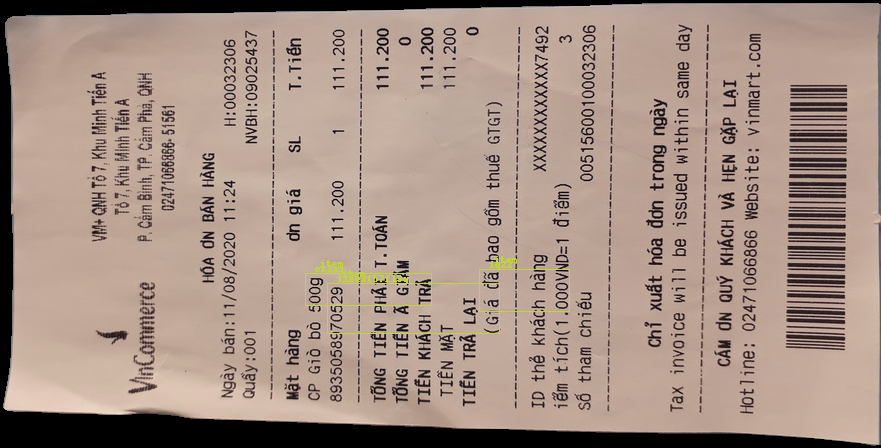

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014rnzgt.jpg
- Function run_saliency run in 0.11613226's
- Function make_warp_img run in 0.00462246's
- Function run_ocr run in 1.07064247's
- Function get_group_text_line run in 0.03233743's
thoi gian layout 0.09178709983825684
ngay:11-08-2020
[CLS]
4
2
6500
10000
5000
8000
82,000congtienhang
thonphuthvy.xaphuthi.huyengialamtphanoi
26,01000
30000
10,000
16000
suatuoimilad80ml
banhmyruockd80g
luongkho5%haichau70g
xucxichcpheo100g
[SEP]


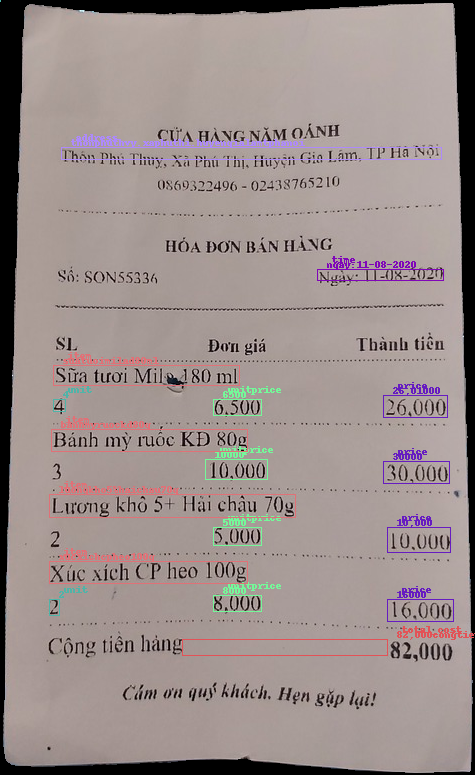

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014cmghn.jpg
- Function run_saliency run in 0.09465361's
- Function make_warp_img run in 0.00453281's
- Function run_ocr run in 1.10267878's
- Function get_group_text_line run in 0.01788568's
thoi gian layout 0.09071755409240723
thoi1gian:20:53:33514/08/2020
:
8000
82000dtongsothanhtoan:
[CLS]
dt0333363328fax0333863328
dc212duongtranphu-campha
8000d
hokhotlg-05


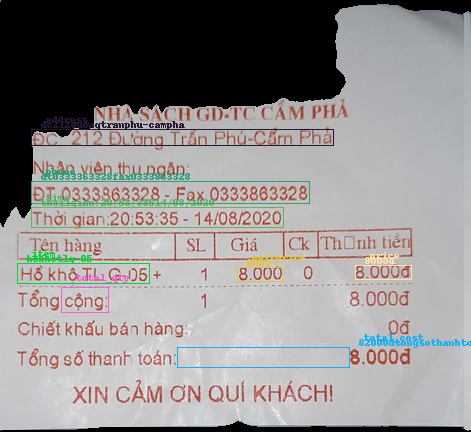

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014ebdtm.jpg
- Function run_saliency run in 0.117594's
- Function make_warp_img run in 0.00613642's
- Function run_ocr run in 1.9855082's
- Function get_group_text_line run in 0.05705667's
thoi gian layout 0.09206485748291016
ngay:111/08/2020-11642
2
2
tongso:11
601000
13,0000
6,
32,000
tongtien
500,000
tienkhachtra:
251,0000tientralaiv
thungan:bh3
chosuiphuthigialam
120000
39000
26,0000
64,0000
nrtlaiboysoomlnt
banhoreo137gnt
miloto180mlnt
mamnamngu750mlnt


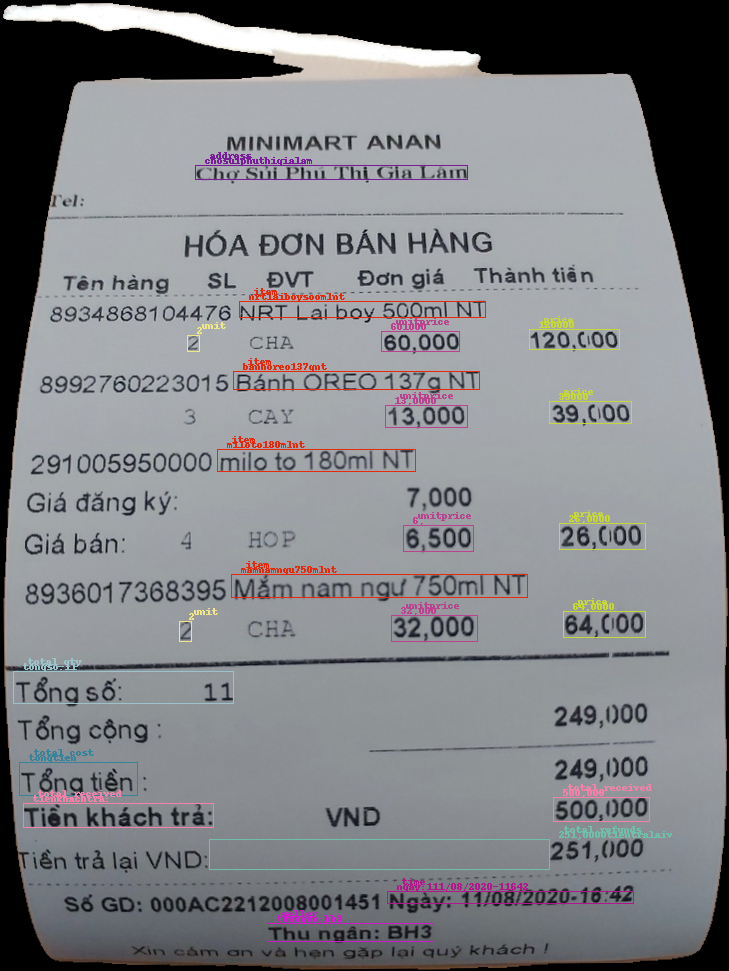

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014heqey.jpg
- Function run_saliency run in 0.12788343's
- Function make_warp_img run in 0.00549316's
- Function run_ocr run in 2.05747771's
- Function get_group_text_line run in 0.13801694's
thoi gian layout 0.10131359100341797
ngay:20/09201910:23:36
0418
186
tongsojuongchangs
1900000
11200000
00000
38,77400tongsotienthanhtoan:
1b000000tiennat
-61,22600tienthoilai
nhanvien:doanquangtrung
tangsh42toak3congtrinhchungcukethopdichvuitrendath-cct2thuocduandautuxaydungkhunhahibrandtaikhudothinoivanphugp.phula,0.hadongsiphanoi
94200
20932
1000000
raumuongkg
thitxayphalockg-hm
dauhutrang


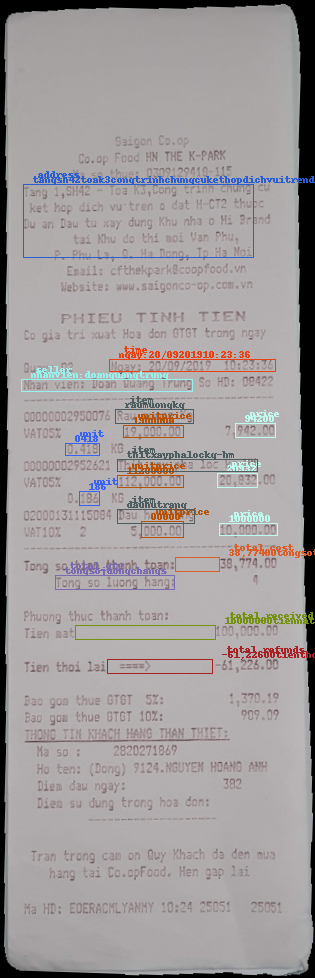

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013wuprd.jpg
- Function run_saliency run in 0.13433909's
- Function make_warp_img run in 0.00654054's
- Function run_ocr run in 1.26338458's
- Function get_group_text_line run in 0.0599401's
thoi gian layout 0.09088850021362305
ngay28/07/2020(06:45ch08:32ch)
[CLS]
10
1251000
265000
l000
120000
120000
tongthanhtoan640.000
squay
sotot
conphaithu640.000d
thungan:dimai
nhaso7khublienkea10namtrungyen(divaongo299phetrungkinhhoacdivaophodoi
1251000
265000
10000
120l000
120000
banhtrangcuonthitheo
laucakeonho
binhnuocvoi
keonuong
cakeothem10


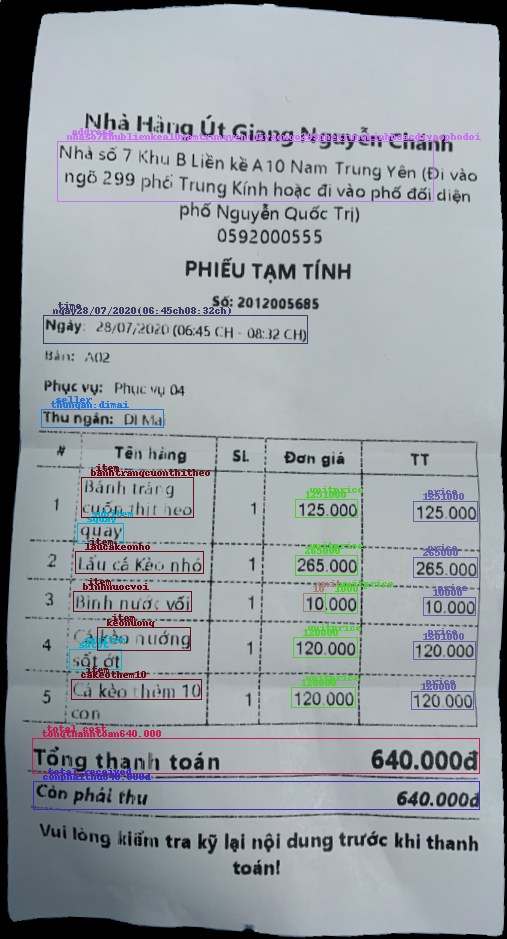

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013dfzcb.jpg
- Function run_saliency run in 0.12124491's
- Function make_warp_img run in 0.00576782's
- Function run_ocr run in 0.93498755's
- Function get_group_text_line run in 0.02087235's
thoi gian layout 0.09626197814941406
ngay:11-08-2020
452000
45,000tongtienhang
0869322496102438765210
[CLS]
thonphuthuyxaphuthihuyenginlam,tphanoi
45000
banhbelgisuamem288g


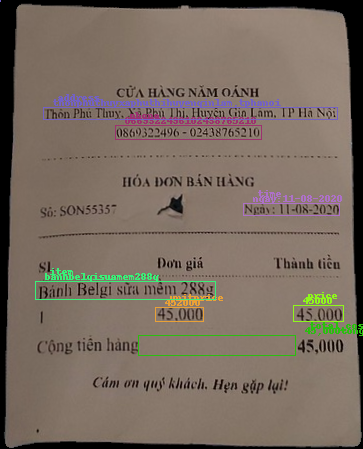

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014bznim.jpg
- Function run_saliency run in 0.11541176's
- Function make_warp_img run in 0.0051527's
- Function run_ocr run in 2.38964891's
- Function get_group_text_line run in 0.20427322's
thoi gian layout 0.13458824157714844
ngay-ban:114/08202017:15
(s)
10
2
0,342
##2
22000
22700
800
1571900
56370
5400
1491900
72
209996tongtienphaitoan
0241.71068866-115310
ine:02471066866
tienkhachtra2000
tientralai
nvbh:09028258
vmthanglonglangquoctlethanglong
dichvongqcaugiayhanoi
22000
22700
800
56370
426
54002
7210
69
otto-banhansangsoithitga190g(718gx5)
chin-sutuongdtchaieo2b1x6x500gr
vmgoodbotschiilengionsangiav1150gt60
/kgmmlthitheoxaymoat
900/kg
mmlthitheoxayloai
mmllthitduiheo(s)
/kg1481kg


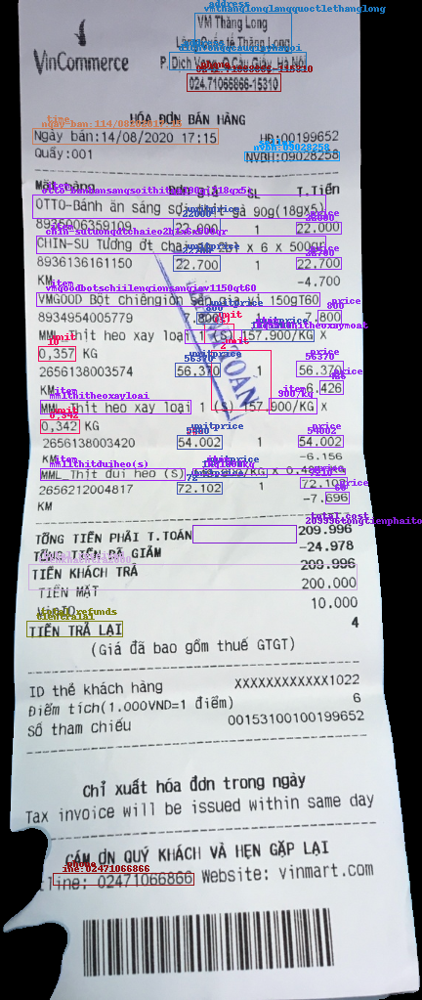

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014awmql.jpg
- Function run_saliency run in 0.09575462's
- Function make_warp_img run in 0.0052588's
- Function run_ocr run in 0.93249297's
- Function get_group_text_line run in 0.01895952's
thoi gian layout 0.0903165340423584
thoigian:08423314/08/2020
98000
98000dtongsothanhtoan:
[CLS]
dt0333863328fax0333863328
dc:212duongtranphu-campha
98loood
2-plvappgiai


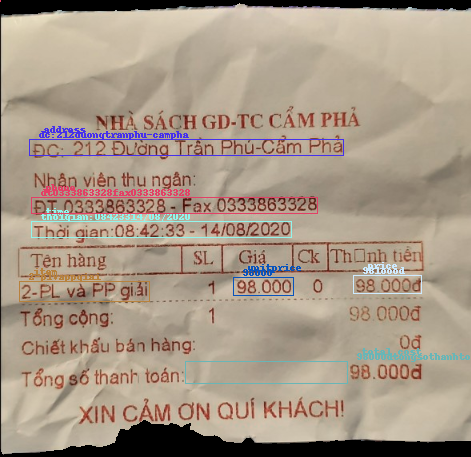

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014omzxy.jpg
- Function run_saliency run in 0.16491079's
- Function make_warp_img run in 0.00857258's
- Function run_ocr run in 1.39413977's
- Function get_group_text_line run in 0.02261162's
thoi gian layout 0.0906836986541748
ngay:15/08/2020-17341
[CLS]
tongso:
195,000
195,000tongcong
195,000
tienkhachtra:
thungan:bh3
chosuiphuthigialam
195,000
suabotcghltu46t900gnt


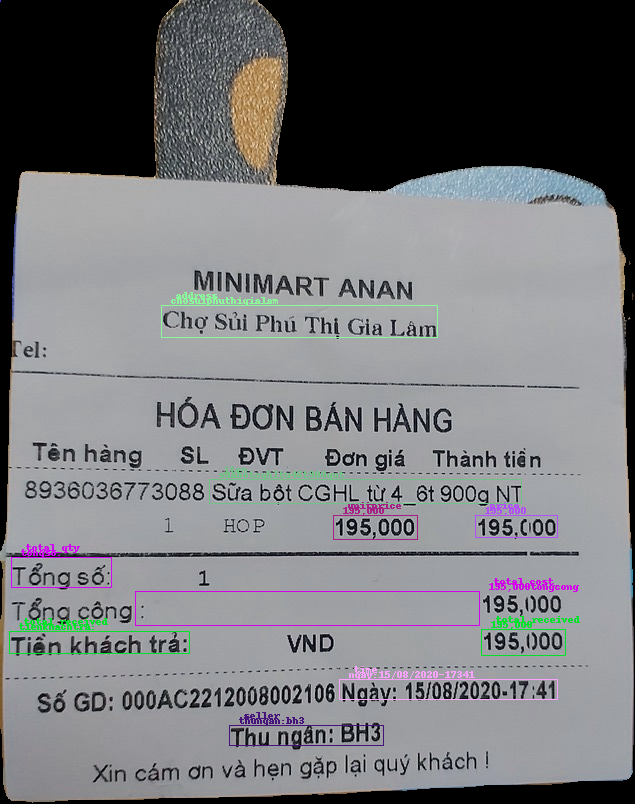

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013utfgs.jpg
- Function run_saliency run in 0.09767175's
- Function make_warp_img run in 0.00551033's
- Function run_ocr run in 0.9005723's
- Function get_group_text_line run in 0.03709173's
thoi gian layout 0.0891871452331543
130820202014
10000
10000
10000
tongcong:70000
dt085819311931
70000tienkhachdua
tien1thua1
[CLS]
tokhujanlap1pcamthuytpcamphaquangninh
60000
10000
10000
trachanh
bimbim
huongduong


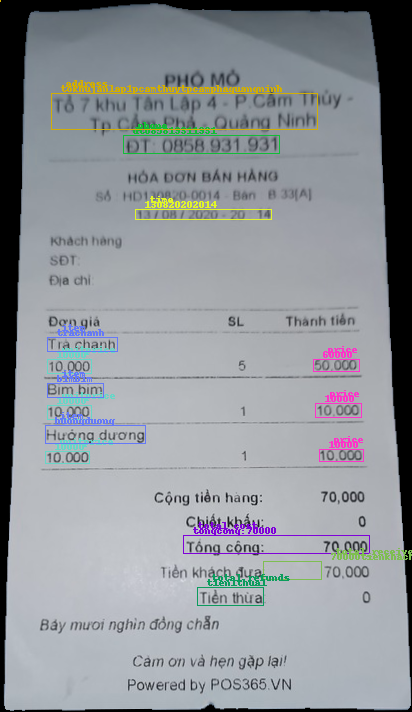

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013djwis.jpg
- Function run_saliency run in 0.13921332's
- Function make_warp_img run in 0.00578094's
- Function run_ocr run in 0.27361798's
- Function get_group_text_line run in 0.06798291's
thoi gian layout 0.08944988250732422
[CLS]
1
5


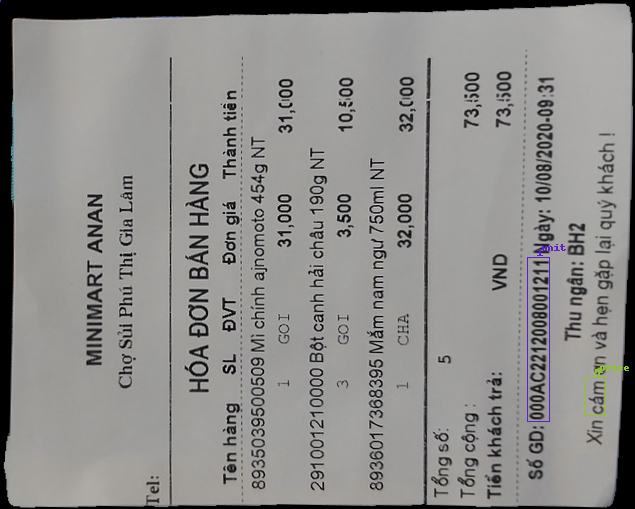

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013chgcz.jpg
- Function run_saliency run in 0.12083459's
- Function make_warp_img run in 0.00530672's
- Function run_ocr run in 1.96172261's
- Function get_group_text_line run in 0.05146098's
thoi gian layout 0.0916891098022461
ngayban:10/08/202009:31
164435
tongtienphait.toan
02402710s6868--43331
hotine:02471066866
tienkhachtra
nvbh:09020166
[CLS]viiibeqnh86tranphuso86-duongtranphupcamtay
tpcamphaquangninh
164435
camcararuotdouc99900/kgx-1646kg


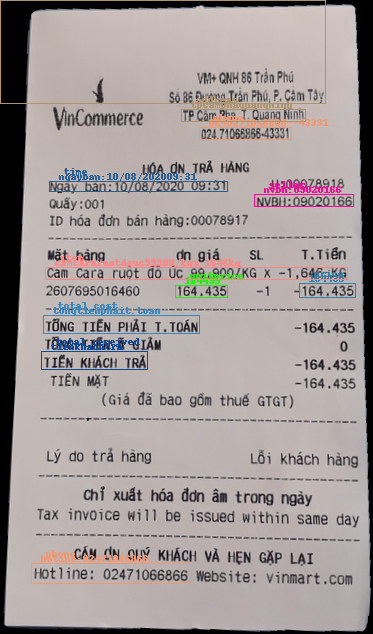

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014ansoe.jpg
- Function run_saliency run in 0.12454367's
- Function make_warp_img run in 0.00512767's
- Function run_ocr run in 1.74486971's
- Function get_group_text_line run in 0.07064724's
thoi gian layout 0.13417339324951172
ngay:17/08/2020-15:37
2tongso
4,000
30,000
301000
tongcong
500,1000tienkhachtra:
402,0000tientralaivnd:
thungan:bh2
chosuiphuthigialam
b000
30,0000
60000
nuoclavie500mlnt
banhtrungtuoichabongkano
banhmithoarcucno


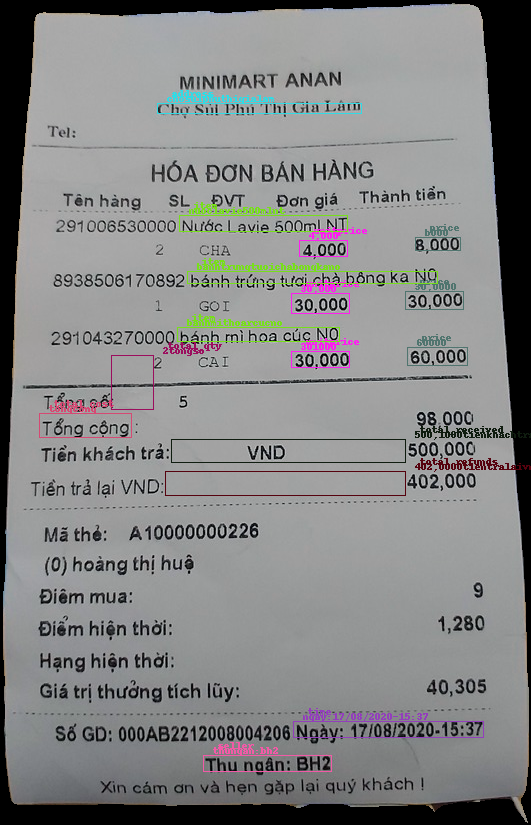

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014eabnk.jpg
- Function run_saliency run in 0.13789701's
- Function make_warp_img run in 0.00562119's
- Function run_ocr run in 0.24145627's
- Function get_group_text_line run in 0.03754854's
thoi gian layout 0.09186005592346191
[CLS]


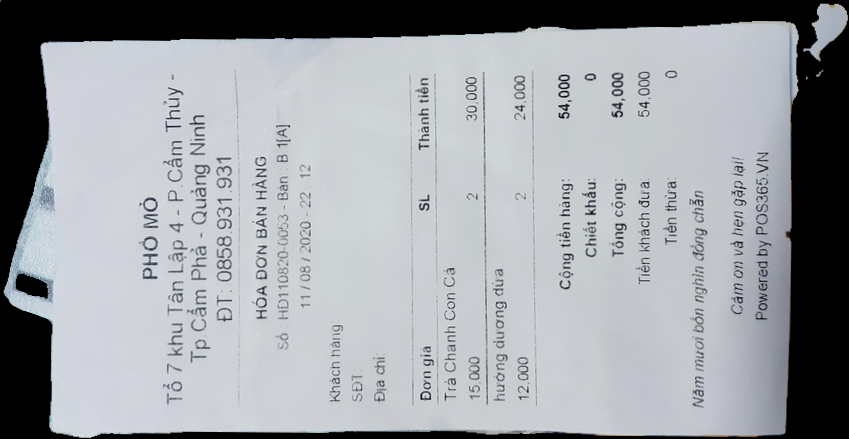

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014nuhli.jpg
- Function run_saliency run in 0.15060711's
- Function make_warp_img run in 0.00608397's
- Function run_ocr run in 0.12423754's
- Function get_group_text_line run in 0.028965's
thoi gian layout 0.08558297157287598
[CLS]
[SEP]


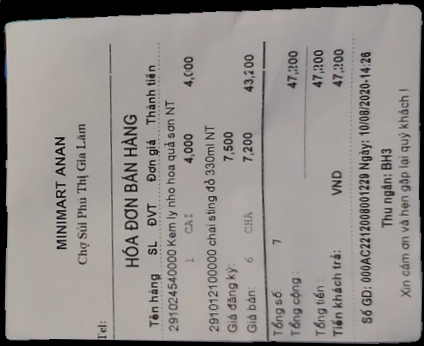

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014hngsl.jpg
- Function run_saliency run in 0.10673833's
- Function make_warp_img run in 0.00470042's
- Function run_ocr run in 1.30465937's
- Function get_group_text_line run in 0.02490783's
thoi gian layout 0.12050318717956543
[CLS]
thoi10gian:10:09:443/08/2020
105000
tongsothanhtoan:105loood
dt0333363328fax0333863328
dc212duongtranphucampha
-105loood
donghobaothuc


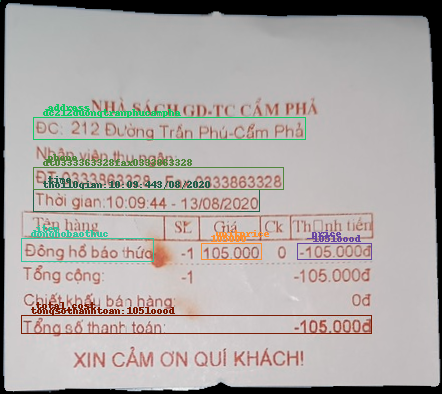

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014ivlka.jpg
- Function run_saliency run in 0.17428589's
- Function make_warp_img run in 0.00915122's
- Function run_ocr run in 1.04984212's
- Function get_group_text_line run in 0.01776934's
thoi gian layout 0.0897972583770752
ngay:12-08-2020
8
6,500
52,000congtienhang
086932249602438765210
[CLS]
thonphuthuy.xaphuthi,huyengia1am,tphanoi
52000
suatuoimilo180ml


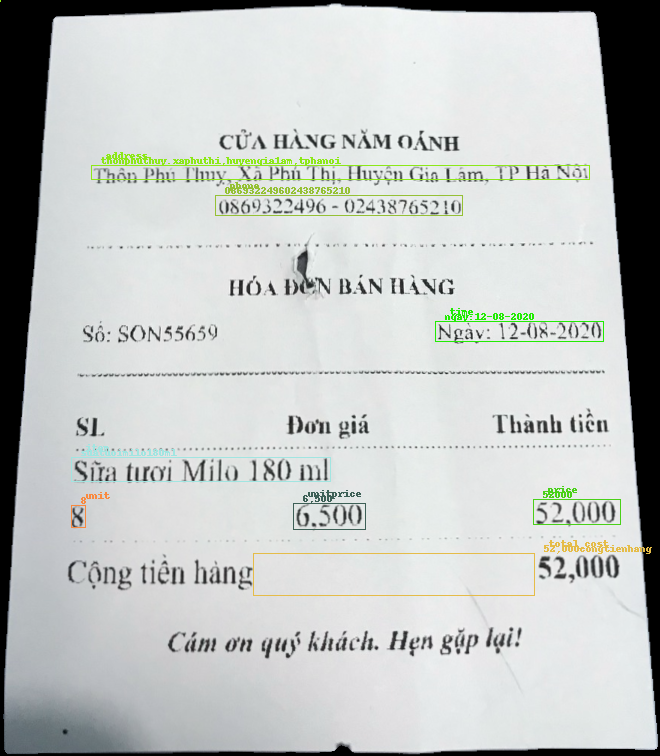

path_img /storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014iwhec.jpg
- Function run_saliency run in 0.12868285's
- Function make_warp_img run in 0.00635958's
- Function run_ocr run in 0.05478549's


IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [13]:
for i in range(len(list_path)):
    path_img='/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/'+list_path[i]

    #     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014qikqz.jpg"
    print("path_img",path_img)
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014zsypc.jpg"
    
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013pqnzb.jpg"
    img=cv2.imread(path_img)
    j=j+1
    random_id=j
    img = resize_and_pad(img, size=1024, pad=False)
    imageio.imwrite(os.path.join(cf.raw_img_dir, "{}.png".format(random_id)), img)

    # SALIENCY PREDICTION
    mask_img = run_saliency(net, img)
    img[~mask_img.astype(bool)] = 0.0
    
    # TRANSFORM AND WRAP IMAGE
    warped_img = make_warp_img(img, mask_img)
#     warped_img=img
    sub_img_fp = os.path.join(cf.cropped_img_dir, "{}.png".format(random_id))
    # print(sub_img_fp)
#     img=warped_img
    imageio.imwrite(sub_img_fp, warped_img)
    cells, heatmap, textboxes = run_ocr(
        text_detector, detector, warped_img, craft_config
    )
    _, lines = get_group_text_line(heatmap, textboxes)
    # print(_, lines )
    for line_id, cell in zip(lines, cells):
        cell["group_id"] = line_id

    # CROP IMG AND UPDATE FINAL CELLS INFO
    sub_h_img, sub_w_img, _ = warped_img.shape
    img_info = dict()
    img_info["h_origin"] = sub_h_img
    img_info["w_origin"] = sub_w_img
    img_info["cells"] = cells
    group_ids = np.array([i for i in lines])
    merged_cells = []
    thickness = 2
    Box_sort_list_new,line_arr=[],[]
    merge_list=[]
    listtext=[]
    list_boxesa=[]
    for group_id in range(max(group_ids) + 1):
        indexes = np.where(group_ids == group_id)[0]
        
        
        if len(indexes) == 0:
            continue
        filter_cells = [cells[index] for index in indexes]
        filter_cells = sorted(filter_cells, key=lambda x: np.mean(x["poly"][::2]))
        so_list=[]
        text1=filter_cells[0]['vietocr_text']
        result = re.match(regex, text1)
        if result:
            result1a=True
        else:
            result = re.match(regex1, text1)
            if result:
                result1a=True
            else:
                result = re.match(regex2, text1)
                if result:
                    result1a=True
                else:
                    result1a=False
                    
        for i in range(1,len(filter_cells),1):
            text=filter_cells[i]['vietocr_text']
    #         print(text)
            result = re.match(regex, text)
            if result:
                result1=True
            else:
                result = re.match(regex1, text)
                if result:
                    result1=True
                else:
                    result = re.match(regex2, text)
                    if result:
                        result1=True
                    else:
                        result1=False

            
            if (result1a==True) and (result1==True):
    #             so_list.append(text)
                so_list.append(i-1) 
                so_list.append(i) 
            result1a=result1
        so_list=list(set(so_list))
        check=False
        boroi=False
        string_list=""
        id_text=-1
        for i in range(len(filter_cells)):
            id_text=id_text+1
            x1b,y1b,x2b,y2b,x3b,y3b,x4b,y4b=filter_cells[i-1]['poly']
            textn=filter_cells[i-1]['vietocr_text']
            group=filter_cells[i-1]['group_id']
            x1,y1,x2,y2,x3,y3,x4,y4=filter_cells[i]['poly']
            text=filter_cells[i]['vietocr_text']
            group=filter_cells[i]['group_id']
            if i not in so_list:
                if check==True :
                    listtext.append(string_list)
                    
                    list_boxesa.append([left_pont,top_point,x3b,y3b])
                    new_poly=[left_pont,top_point,x2b,y2b,x3b,y3b,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["vietocr_text"] = string_list
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    merged_cells.append(copy.deepcopy(tmp_cell))
                    string_list=""
                merged_cells.append(filter_cells[i])
                listtext.append(text)
                list_boxesa.append([x1,y1,x3,y3])
                check=False
            else:
    #             print(text)
                if (abs(x2b-x1)>min(abs(x2-x1),abs(x2b-x1b)) ) and (check==True):
                    listtext.append(string_list)
                    list_boxesa.append([left_pont,top_point,x3b,y3b])
                    new_poly=[left_pont,top_point,x2b,y2b,x3b,y3b,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["vietocr_text"] = string_list
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    merged_cells.append(copy.deepcopy(tmp_cell))
                
                    string_list=""
                    left_pont,top_point,right_point,bottom_point=x1,y1,x4,y4
                if check==False:
    #                 print("text123",text)
                    left_pont,top_point,right_point,bottom_point=x1,y1,x4,y4
                if i == len(filter_cells)-1:
                    string_list=string_list+text
    #                 print("string_lists",string_list)
                    
                    listtext.append(string_list)
                    
                    list_boxesa.append([left_pont,top_point,x3,y3])
                    new_poly=[left_pont,top_point,x2,y2,x3,y3,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    tmp_cell["vietocr_text"] = string_list
                    merged_cells.append(copy.deepcopy(tmp_cell))
                    
                string_list=string_list+text
    #             print("string_list_fil",string_list,"i",i,len(filter_cells))
                check=True   
    bbox=list_boxesa
    text=listtext
    text=no_accent_vietnamese(text)
#         print(merged_cells)
        #     break


    
    j=0
    t2=time.time()
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")

    font = ImageFont.load_default()
    width, height = image.size
    words_example=[]
    boxes_example=[]
    for i in range(len(bbox)):
        x1 = bbox[i][0]
        y1 = bbox[i][1]
        x3 = bbox[i][2]
        y3 = bbox[i][3]
        txt=text[i]
        box = [x1, y1, x3, y3]
        box = normalize_bbox(box, width=width, height=height)
        if len(txt) < 1: 
            continue
        if min(box) < 0 or max(box) > 1000: # another bug in which a box had -4
            continue
        if ((box[3] - box[1]) < 0) or ((box[2] - box[0]) < 0): # another bug in which a box difference was -12
            continue
        words_example.append(txt)
        boxes_example.append(box)
    encoded_inputs=processor(image, words_example, boxes=boxes_example,return_tensors="pt")
    outputs = model(input_ids=encoded_inputs['input_ids'].to(device), attention_mask=encoded_inputs['attention_mask'].to(device),
                    token_type_ids=encoded_inputs['token_type_ids'].to(device), bbox=encoded_inputs['bbox'].to(device),
                    image=encoded_inputs['image'].to(device))
    token=[]
    predictions = outputs.logits.argmax(-1).squeeze().tolist()
    token_boxes = encoded_inputs.bbox.squeeze().tolist()
    true_predictions = [id2label[pred] for idx, pred in enumerate(predictions)]
    true_boxes = [unnormalize_box(box, width, height) for idx, box in enumerate(token_boxes) ]
#     for i in (encoded_inputs.input_ids.squeeze().tolist()):
#         token.append(processor.tokenizer.decode(i))
#     image=warped_img
#     image = Image.fromarray(image)
#     draw = ImageDraw.Draw(image, "RGBA")
#     for prediction, box in zip(true_predictions, true_boxes):
#         predicted_label = (prediction).lower()
#         draw.rectangle(box, outline=label2color[predicted_label])
#         draw.text((box[0]+10, box[1]-10), text=predicted_label, fill=label2color[predicted_label], font=font)
#     image.show()
#     break
    t3=time.time()
    print("thoi gian layout",t3-t2)
    token=[]
    for i in (encoded_inputs.input_ids.squeeze().tolist()):
        token.append(processor.tokenizer.decode(i))

#     merged_cells = []
    group_ids=[]
    for i in true_predictions:
        i=i.replace("b-","")
        i=i.replace("i-","")
        i=i.replace("e-","")
        i=i.replace("s-price","price")
        i=i.replace("s-unit price","unit price")
        group_ids.append(i)
    group_ids=np.array(group_ids)
    group_ids123=set(group_ids)
    get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
    colors = get_colors(len(group_ids123))
    label2color = {label: colors[idx] for idx, label in enumerate(group_ids123)}
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
    for group_id in set(group_ids):
        if group_id=="other":
            continue
        group_id=group_id
    #     print(group_id)
        indexes = np.where(group_ids == group_id)[0]
        indexes123=np.array([i for i in indexes])
        indexes1234=np.diff(indexes123)
        idx_bs=np.where(indexes1234!=1)[0]+1
    #     print(idx_bs)
        st=0
    #     print("indexes123",indexes123)
        idx_bs = np.append(idx_bs, len(indexes1234)+1)
        for idx_b in idx_bs:
            ed=idx_b
            indexaa=indexes123[st:ed]

    #         print(indexaa)
            token_a=""
    #         print("idx_bs",idx_bs)
    #         print("indexaa",indexaa)
    #         print(indexaa[0],"asd",indexaa[-1])
    #         print(token[indexaa[0]])
    #         print(token[indexaa[-1]])
            
    #         print("Asd",token[indexaa[0]:indexaa[-1]])
            for i in token[indexaa[0]:indexaa[-1]+1]:
                token_a=token_a+i.replace("##","")
            if len(indexaa)==1:
    #             print(group_id)
    #             print(idx_bs)
                token_a=token[indexaa[0]]
    #             print(indexaa)
    #             print(token[indexaa[0]:indexaa[-1]+1])
    #             print(token[indexaa[0]-1])
    #             print(group_id)
    #             print("token_z",token_a)
    #             print("aaa",token_a)
    #             print("true_boxes",true_boxes[indexaa[0]])
    #             print("asd")            
            box=[int(true_boxes[indexaa[0]][0]),int(true_boxes[indexaa[0]][1]),int(true_boxes[indexaa[-1]][2]),int(true_boxes[indexaa[-1]][3]) ]

    #         print(true_boxes[indexaa[-1]])
    #         print(group_id)
            draw.rectangle(box, outline=label2color[group_id]) 
            print(token_a)
            draw.text((box[0]+10, box[1]-10), text=token_a, fill=label2color[group_id], font=font)
            draw.text((box[0]+15, box[1]-15), text=str(group_id), fill=label2color[group_id], font=font)
    #         print(token[indexaa[0]:indexaa[-1]])
    #         print("token_a",token_a)
            st=ed
    image.show()
#     break
   

In [ ]:
words_example

In [ ]:
import cv2
from PIL import Image
# path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013iadlw.jpg"
# #     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014qikqz.jpg"
# print("path_img",path_img)
# #     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014zsypc.jpg"

# #     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013pqnzb.jpg"
# img=cv2.imread(path_img)
image = Image.fromarray(warped_img)
image.show()

In [ ]:
import cv2


In [ ]:
img

In [ ]:
image=warped_img
image = Image.fromarray(image)
draw = ImageDraw.Draw(image, "RGBA")
true_boxes = [unnormalize_box(box, width, height) for idx, box in enumerate(boxes_example) ]
for prediction, box in zip(words_example, true_boxes):
    predicted_label = (prediction).lower()
    draw.rectangle(box, outline=label2color['e-price'])
    draw.text((box[0]+10, box[1]-10), text=predicted_label, fill=label2color['e-price'], font=font)
image.show()

In [ ]:
label2color

In [ ]:
token_boxes

In [ ]:
words_example

In [ ]:
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
    image.show()
    encoded_inputs=processor(image, words_example, boxes=boxes_example,return_tensors="pt")
    outputs = model(input_ids=encoded_inputs['input_ids'].to(device), attention_mask=encoded_inputs['attention_mask'].to(device),
                    token_type_ids=encoded_inputs['token_type_ids'].to(device), bbox=encoded_inputs['bbox'].to(device),
                    image=encoded_inputs['image'].to(device))
    predictions = outputs.logits.argmax(-1).squeeze().tolist()
    token_boxes = encoded_inputs.bbox.squeeze().tolist()
    true_predictions = [id2label[pred] for idx, pred in enumerate(predictions)]
    true_boxes = [unnormalize_box(box, width, height) for idx, box in enumerate(token_boxes) ]
    t3=time.time()
    print("thoi gian layout",t3-t2)
    token=[]
    for i in (encoded_inputs.input_ids.squeeze().tolist()):
        token.append(processor.tokenizer.decode(i))

    for prediction, box in zip(true_predictions, true_boxes):
        predicted_label = (prediction).lower()
        draw.rectangle(box, outline=label2color[predicted_label])
        draw.text((box[0]+10, box[1]-10), text=predicted_label, fill=label2color[predicted_label], font=font)
    
    # for i in range(len(bbox)):
    #     print(bbox[i])
    #     print(text[i])
    #     text1 = text[i].encode("utf-8")
    #     draw.rectangle(bbox[i], outline=label2color[4])
    #     draw.text((bbox[i][0]+10, bbox[i][1]-10), text=text1,fill=label2color[4], font=font) 
    # # print(line_arr)
    
    image.show()
    # image.save("1.jpg")
 
    

In [ ]:
len(text)

In [ ]:
true_boxes

In [ ]:
 group_ids = np.array([i[2:] for i in true_predictions])

In [ ]:
true_boxes

In [ ]:
len(true_predictions)

In [ ]:
len(token)

In [ ]:
len(true_boxes)

In [ ]:
true_boxes123=np.array([int(i[0]) for i in true_boxes])
true_boxes1234=np.diff(true_boxes123)
idx_bs=np.where(true_boxes1234!=0)[0]+1
idx_bs = np.append(idx_bs, len(true_boxes1234)+1)
idx_bs

In [ ]:
true_boxes123

In [ ]:
true_boxes1234=np.diff(true_boxes123)
idx_bs=np.where(true_boxes1234!=0)[0]+1
idx_bs = np.append(idx_bs, len(true_boxes1234)+1)
idx_bs

In [ ]:
true_boxes1234

In [ ]:
len(true_boxes1234)

In [ ]:
idx_bs=np.where(true_boxes1234!=0)[0]+1
idx_bs = np.append(idx_bs, len(true_boxes1234)+1)
idx_bs

In [ ]:
true_boxes1234

In [ ]:
idx_bs

In [ ]:


st=0
list_text=[]
box_list=[]
predict=[]
group_ids=[]
for i in true_predictions:
    i=i.replace("b-","")
    i=i.replace("i-","")
    i=i.replace("e-","")
    i=i.replace("s-price","price")
    i=i.replace("s-unit price","unit price")
    group_ids.append(i)
group_ids=np.array(group_ids)

for idx_b in idx_bs:
    ed=idx_b
    token_a=""
    label=[]
    for i in token[st:ed]:
        token_a=token_a+i.replace("##","")
    for i in group_ids[st:ed]:
        label.append(i)
    label1=np.array(label)
    maxid=0
    for i in group_ids[st:ed]:
#         print(i)
#         print(label1)
        indexes = np.where(label1 == i)[0]
        maxid=max(len(indexes),maxid)
        if len(indexes)!=len(label1) and len(indexes)>=maxid:
            indexes1=indexes
        else:
            indexes1=[0]
#             print(label1[indexes1])
#     print((label1[indexes1]))
#     print(set(label1[indexes1]))
    predict.append(list(set(label1[indexes1]))[0])
#     predict.append(label)  
    box_list.append([int(true_boxes[st][0]), int(true_boxes[st][1]),int(true_boxes[st][2]),int(true_boxes[st][3])])
    list_text.append(token_a)
#     token_a=""
#     for i in token[indexaa[0]:indexaa[-1]+1]:
#         token_a=token_a+i.replace("##","")
#     if len(indexaa)==1:
#         token_a=token[indexaa[0]]         
#     box=[int(true_boxes[indexaa[0]][0]),int(true_boxes[indexaa[0]][1]),int(true_boxes[indexaa[-1]][2]),int(true_boxes[indexaa[-1]][3]) ]

#     draw.rectangle(box, outline=label2color[group_id]) 
#     draw.text((box[0]+10, box[1]-10), text=token_a, fill=label2color[group_id], font=font)
#     draw.text((box[0]+15, box[1]-15), text=str(group_id), fill=label2color[group_id], font=font)
    st=ed
list_text=list_text[1:-1]
box_list=box_list[1:-1]
predict=predict[1:-1]
image=warped_img
image = Image.fromarray(image)
draw = ImageDraw.Draw(image, "RGBA")
for i in range(len(list_text)) : 
#     print(box_list[i])
    box=box_list[i]
    draw.rectangle(box, outline=label2color[predict[i]]) 
    draw.text((box[0]+10, box[1]-10), text=list_text[i], fill=label2color[predict[i]], font=font)
    draw.text((box[0]+15, box[1]-15), text=str(predict[i]), fill=label2color[predict[i]], font=font)

image.show()

In [ ]:
len(box_list)

In [ ]:
for i in range(len(list_path)):
    path_img='/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/'+list_path[i]
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014qikqz.jpg"
    print("path_img",path_img)
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014zsypc.jpg"
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013iadlw.jpg"
    
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013pqnzb.jpg"
    img=cv2.imread(path_img)
    j=j+1
    random_id=j
    img = resize_and_pad(img, size=1024, pad=False)
    imageio.imwrite(os.path.join(cf.raw_img_dir, "{}.png".format(random_id)), img)

    # SALIENCY PREDICTION
    mask_img = run_saliency(net, img)
    img[~mask_img.astype(bool)] = 0.0
    
    # TRANSFORM AND WRAP IMAGE
    warped_img = make_warp_img(img, mask_img)
    sub_img_fp = os.path.join(cf.cropped_img_dir, "{}.png".format(random_id))
    # print(sub_img_fp)
#     img=warped_img
    imageio.imwrite(sub_img_fp, warped_img)
    cells, heatmap, textboxes = run_ocr(
        text_detector, detector, warped_img, craft_config
    )
    _, lines = get_group_text_line(heatmap, textboxes)
    # print(_, lines )
    for line_id, cell in zip(lines, cells):
        cell["group_id"] = line_id

    # CROP IMG AND UPDATE FINAL CELLS INFO
    sub_h_img, sub_w_img, _ = warped_img.shape
    img_info = dict()
    img_info["h_origin"] = sub_h_img
    img_info["w_origin"] = sub_w_img
    img_info["cells"] = cells
    group_ids = np.array([i for i in lines])
    merged_cells = []
    thickness = 2
    Box_sort_list_new,line_arr=[],[]
    merge_list=[]
    listtext=[]
    list_boxesa=[]
    for group_id in range(max(group_ids) + 1):
        indexes = np.where(group_ids == group_id)[0]
        if len(indexes) == 0:
            continue
        filter_cells = [cells[index] for index in indexes]
        filter_cells = sorted(filter_cells, key=lambda x: np.mean(x["poly"][::2]))
        so_list=[]
        text1=filter_cells[0]['vietocr_text']
        result = re.match(regex, text1)
        if result:
            result1a=True
        else:
            result = re.match(regex1, text1)
            if result:
                result1a=True
            else:
                result = re.match(regex2, text1)
                if result:
                    result1a=True
                else:
                    result1a=False
                    
        for i in range(1,len(filter_cells),1):
            text=filter_cells[i]['vietocr_text']
    #         print(text)
            result = re.match(regex, text)
            if result:
                result1=True
            else:
                result = re.match(regex1, text)
                if result:
                    result1=True
                else:
                    result = re.match(regex2, text)
                    if result:
                        result1=True
                    else:
                        result1=False  
            if (result1a==True) and (result1==True):
    #             so_list.append(text)
                so_list.append(i-1) 
                so_list.append(i) 
            result1a=result1
        so_list=list(set(so_list))
        check=False
        boroi=False
        string_list=""
        id_text=-1
        for i in range(len(filter_cells)):
            id_text=id_text+1
            x1b,y1b,x2b,y2b,x3b,y3b,x4b,y4b=filter_cells[i-1]['poly']
            textn=filter_cells[i-1]['vietocr_text']
            group=filter_cells[i-1]['group_id']
            x1,y1,x2,y2,x3,y3,x4,y4=filter_cells[i]['poly']
            text=filter_cells[i]['vietocr_text']
            group=filter_cells[i]['group_id']
            if i not in so_list:
                if check==True :
                    listtext.append(string_list)
                    
                    list_boxesa.append([left_pont,top_point,x3b,y3b])
                    new_poly=[left_pont,top_point,x2b,y2b,x3b,y3b,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["vietocr_text"] = string_list
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    merged_cells.append(copy.deepcopy(tmp_cell))
                    string_list=""
                merged_cells.append(filter_cells[i])
                listtext.append(text)
                list_boxesa.append([x1,y1,x3,y3])
                check=False
            else:
    #             print(text)
                if (abs(x2b-x1)>min(abs(x2-x1),abs(x2b-x1b)) ) and (check==True):
                    listtext.append(string_list)
                    list_boxesa.append([left_pont,top_point,x3b,y3b])
                    new_poly=[left_pont,top_point,x2b,y2b,x3b,y3b,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["vietocr_text"] = string_list
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    merged_cells.append(copy.deepcopy(tmp_cell))
                
                    string_list=""
                    left_pont,top_point,right_point,bottom_point=x1,y1,x4,y4
                if check==False:
    #                 print("text123",text)
                    left_pont,top_point,right_point,bottom_point=x1,y1,x4,y4
                if i == len(filter_cells)-1:
                    string_list=string_list+text
    #                 print("string_lists",string_list)
                    
                    listtext.append(string_list)
                    
                    list_boxesa.append([left_pont,top_point,x3,y3])
                    new_poly=[left_pont,top_point,x2,y2,x3,y3,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    tmp_cell["vietocr_text"] = string_list
                    merged_cells.append(copy.deepcopy(tmp_cell))
                    
                string_list=string_list+text
    #             print("string_list_fil",string_list,"i",i,len(filter_cells))
                check=True   
    bbox=list_boxesa
    text=listtext
    
#         print(merged_cells)
        #     break



    j=0
    t2=time.time()
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
    
    font = ImageFont.load_default()
    width, height = image.size
    words_example=[]
    boxes_example=[]
    for i in range(len(bbox)):
        x1 = bbox[i][0]
        y1 = bbox[i][1]
        x3 = bbox[i][2]
        y3 = bbox[i][3]
        txt=text[i]
        box = [x1, y1, x3, y3]
        box = normalize_bbox(box, width=width, height=height)
        if len(txt) < 1: 
            continue
        if min(box) < 0 or max(box) > 1000: # another bug in which a box had -4
            continue
        if ((box[3] - box[1]) < 0) or ((box[2] - box[0]) < 0): # another bug in which a box difference was -12
            continue
        words_example.append(txt)
        boxes_example.append(box)
    encoded_inputs=processor(image, words_example, boxes=boxes_example,return_tensors="pt")
    outputs = model(input_ids=encoded_inputs['input_ids'].to(device), attention_mask=encoded_inputs['attention_mask'].to(device),
                    token_type_ids=encoded_inputs['token_type_ids'].to(device), bbox=encoded_inputs['bbox'].to(device),
                    image=encoded_inputs['image'].to(device))
    predictions = outputs.logits.argmax(-1).squeeze().tolist()
    get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
    colors = get_colors(len(labels))
    label2color = {label: colors[idx] for idx, label in enumerate(labels)}
    predictions = outputs.logits.argmax(-1).squeeze().tolist()
    token_boxes = encoded_inputs.bbox.squeeze().tolist()
    true_predictions = [id2label[pred] for idx, pred in enumerate(predictions)]
    true_boxes = [unnormalize_box(box, width, height) for idx, box in enumerate(token_boxes) ]
   
    text=no_accent_vietnamese(text)
    
    t3=time.time()
    print("thoi gian layout",t3-t2)
    token=[]
    for i in (encoded_inputs.input_ids.squeeze().tolist()):
        token.append(processor.tokenizer.decode(i))

    



    st=0
    list_text=[]
    box_list=[]
    predict=[]
    group_ids=[]
    for i in true_predictions:
#         i=i.replace("b-","")
#         i=i.replace("i-","")
#         i=i.replace("e-","")
#         i=i.replace("s-price","price")
#         i=i.replace("s-phone","phone")
#         i=i.replace("s-unit price","unit price")
        group_ids.append(i)
    group_ids=np.array(group_ids)
    true_boxes123=np.array([int(i[0]+i[1]+i[3]+i[2]) for i in true_boxes])
    true_boxes1234=np.diff(true_boxes123)
    idx_bs=np.where(true_boxes1234!=0)[0]+1
    idx_bs = np.append(idx_bs, len(true_boxes1234)+1)
    for idx_b in idx_bs:
        ed=idx_b
        token_a=""
        label=[]
        for i in token[st:ed]:
            token_a=token_a+i.replace("##","")
        for i in group_ids[st:ed]:
            label.append(i)
        label1=np.array(label)
        maxid=0
        for i in group_ids[st:ed]:
    #         print(i)
    #         print(label1)
            indexes = np.where(label1 == i)[0]
            maxid=max(len(indexes),maxid)
            if len(indexes)!=len(label1) and len(indexes)>=maxid:
                indexes1=indexes
            else:
                indexes1=[0]
    #             print(label1[indexes1])
    #     print((label1[indexes1]))
    #     print(set(label1[indexes1]))
#         print(label1)
        predict.append(list(set(label1[indexes1]))[0])
    #     predict.append(label)  
        box_list.append([int(true_boxes[st][0]), int(true_boxes[st][1]),int(true_boxes[st][2]),int(true_boxes[st][3])])
        list_text.append(token_a)
#         print(token_a)
    #     token_a=""
    #     for i in token[indexaa[0]:indexaa[-1]+1]:
    #         token_a=token_a+i.replace("##","")
    #     if len(indexaa)==1:
    #         token_a=token[indexaa[0]]         
    #     box=[int(true_boxes[indexaa[0]][0]),int(true_boxes[indexaa[0]][1]),int(true_boxes[indexaa[-1]][2]),int(true_boxes[indexaa[-1]][3]) ]

    #     draw.rectangle(box, outline=label2color[group_id]) 
    #     draw.text((box[0]+10, box[1]-10), text=token_a, fill=label2color[group_id], font=font)
    #     draw.text((box[0]+15, box[1]-15), text=str(group_id), fill=label2color[group_id], font=font)
        st=ed
    
    list_text=list_text[1:-1]
    box_list=box_list[1:-1]
    predict=predict[1:-1]
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
    for i in range(len(list_text)) : 
    #     print(box_list[i])
        box=box_list[i]
        if predict[i]!="other":
            draw.rectangle(box, outline=label2color[predict[i]]) 
            draw.text((box[0]+10, box[1]-10), text=list_text[i], fill=label2color[predict[i]], font=font)
            draw.text((box[0]+15, box[1]-15), text=str(predict[i]), fill=label2color[predict[i]], font=font)

    image.show()
    break

In [ ]:
for i in range(len(list_path)):
    path_img='/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/'+list_path[i]
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014qikqz.jpg"
    print("path_img",path_img)
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145014zsypc.jpg"
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013iadlw.jpg"
    
#     path_img="/storage/quangtm/KIE_invoice_minimal/mcocr2021_public_train_test_data/mcocr_public_train_test_shared_data/mcocr_train_data/train_images/mcocr_public_145013pqnzb.jpg"
    img=cv2.imread(path_img)
    j=j+1
    random_id=j
    img = resize_and_pad(img, size=1024, pad=False)
    imageio.imwrite(os.path.join(cf.raw_img_dir, "{}.png".format(random_id)), img)

    # SALIENCY PREDICTION
    mask_img = run_saliency(net, img)
    img[~mask_img.astype(bool)] = 0.0
    
    # TRANSFORM AND WRAP IMAGE
    warped_img = make_warp_img(img, mask_img)
    sub_img_fp = os.path.join(cf.cropped_img_dir, "{}.png".format(random_id))
    # print(sub_img_fp)
#     img=warped_img
    imageio.imwrite(sub_img_fp, warped_img)
    cells, heatmap, textboxes = run_ocr(
        text_detector, detector, warped_img, craft_config
    )
    _, lines = get_group_text_line(heatmap, textboxes)
    # print(_, lines )
    for line_id, cell in zip(lines, cells):
        cell["group_id"] = line_id

    # CROP IMG AND UPDATE FINAL CELLS INFO
    sub_h_img, sub_w_img, _ = warped_img.shape
    img_info = dict()
    img_info["h_origin"] = sub_h_img
    img_info["w_origin"] = sub_w_img
    img_info["cells"] = cells
    group_ids = np.array([i for i in lines])
    merged_cells = []
    thickness = 2
    Box_sort_list_new,line_arr=[],[]
    merge_list=[]
    listtext=[]
    list_boxesa=[]
    for group_id in range(max(group_ids) + 1):
        indexes = np.where(group_ids == group_id)[0]
        if len(indexes) == 0:
            continue
        filter_cells = [cells[index] for index in indexes]
        filter_cells = sorted(filter_cells, key=lambda x: np.mean(x["poly"][::2]))
        so_list=[]
        text1=filter_cells[0]['vietocr_text']
        result = re.match(regex, text1)
        if result:
            result1a=True
        else:
            result = re.match(regex1, text1)
            if result:
                result1a=True
            else:
                result = re.match(regex2, text1)
                if result:
                    result1a=True
                else:
                    result1a=False
                    
        for i in range(1,len(filter_cells),1):
            text=filter_cells[i]['vietocr_text']
    #         print(text)
            result = re.match(regex, text)
            if result:
                result1=True
            else:
                result = re.match(regex1, text)
                if result:
                    result1=True
                else:
                    result = re.match(regex2, text)
                    if result:
                        result1=True
                    else:
                        result1=False  
            if (result1a==True) and (result1==True):
    #             so_list.append(text)
                so_list.append(i-1) 
                so_list.append(i) 
            result1a=result1
        so_list=list(set(so_list))
        check=False
        boroi=False
        string_list=""
        id_text=-1
        for i in range(len(filter_cells)):
            id_text=id_text+1
            x1b,y1b,x2b,y2b,x3b,y3b,x4b,y4b=filter_cells[i-1]['poly']
            textn=filter_cells[i-1]['vietocr_text']
            group=filter_cells[i-1]['group_id']
            x1,y1,x2,y2,x3,y3,x4,y4=filter_cells[i]['poly']
            text=filter_cells[i]['vietocr_text']
            group=filter_cells[i]['group_id']
            if i not in so_list:
                if check==True :
                    listtext.append(string_list)
                    
                    list_boxesa.append([left_pont,top_point,x3b,y3b])
                    new_poly=[left_pont,top_point,x2b,y2b,x3b,y3b,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["vietocr_text"] = string_list
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    merged_cells.append(copy.deepcopy(tmp_cell))
                    string_list=""
                merged_cells.append(filter_cells[i])
                listtext.append(text)
                list_boxesa.append([x1,y1,x3,y3])
                check=False
            else:
    #             print(text)
                if (abs(x2b-x1)>min(abs(x2-x1),abs(x2b-x1b)) ) and (check==True):
                    listtext.append(string_list)
                    list_boxesa.append([left_pont,top_point,x3b,y3b])
                    new_poly=[left_pont,top_point,x2b,y2b,x3b,y3b,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["vietocr_text"] = string_list
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    merged_cells.append(copy.deepcopy(tmp_cell))
                
                    string_list=""
                    left_pont,top_point,right_point,bottom_point=x1,y1,x4,y4
                if check==False:
    #                 print("text123",text)
                    left_pont,top_point,right_point,bottom_point=x1,y1,x4,y4
                if i == len(filter_cells)-1:
                    string_list=string_list+text
    #                 print("string_lists",string_list)
                    
                    listtext.append(string_list)
                    
                    list_boxesa.append([left_pont,top_point,x3,y3])
                    new_poly=[left_pont,top_point,x2,y2,x3,y3,right_point,bottom_point]
                    tmp_cell = copy.deepcopy(filter_cells[0])
                    tmp_cell["poly"] = new_poly
                    tmp_cell["group_id"]=filter_cells[0]["group_id"]+1000000
                    tmp_cell["vietocr_text"] = string_list
                    merged_cells.append(copy.deepcopy(tmp_cell))
                    
                string_list=string_list+text
    #             print("string_list_fil",string_list,"i",i,len(filter_cells))
                check=True   
    bbox=list_boxesa
    text=listtext
    text=no_accent_vietnamese(text)
#         print(merged_cells)
        #     break



    j=0
    t2=time.time()
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
    
    font = ImageFont.load_default()
    width, height = image.size
    words_example=[]
    boxes_example=[]
    for i in range(len(bbox)):
        x1 = bbox[i][0]
        y1 = bbox[i][1]
        x3 = bbox[i][2]
        y3 = bbox[i][3]
        txt=text[i]
        box = [x1, y1, x3, y3]
        box = normalize_bbox(box, width=width, height=height)
        if len(txt) < 1: 
            continue
        if min(box) < 0 or max(box) > 1000: # another bug in which a box had -4
            continue
        if ((box[3] - box[1]) < 0) or ((box[2] - box[0]) < 0): # another bug in which a box difference was -12
            continue
        words_example.append(txt)
        boxes_example.append(box)
    encoded_inputs=processor(image, words_example, boxes=boxes_example,return_tensors="pt")
    outputs = model(input_ids=encoded_inputs['input_ids'].to(device), attention_mask=encoded_inputs['attention_mask'].to(device),
                    token_type_ids=encoded_inputs['token_type_ids'].to(device), bbox=encoded_inputs['bbox'].to(device),
                    image=encoded_inputs['image'].to(device))
    predictions = outputs.logits.argmax(-1).squeeze().tolist()
    get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
    colors = get_colors(len(labels))
    label2color = {label: colors[idx] for idx, label in enumerate(labels)}
    predictions = outputs.logits.argmax(-1).squeeze().tolist()
    token_boxes = encoded_inputs.bbox.squeeze().tolist()
    true_predictions = [id2label[pred] for idx, pred in enumerate(predictions)]
    true_boxes = [unnormalize_box(box, width, height) for idx, box in enumerate(token_boxes) ]
   
    
    
    t3=time.time()
    print("thoi gian layout",t3-t2)
    token=[]
    for i in (encoded_inputs.input_ids.squeeze().tolist()):
        token.append(processor.tokenizer.decode(i))

    



    st=0
    list_text=[]
    box_list=[]
    predict=[]
    group_ids=[]
    for i in true_predictions:
#         i=i.replace("b-","")
#         i=i.replace("i-","")
#         i=i.replace("e-","")
#         i=i.replace("s-price","price")
#         i=i.replace("s-phone","phone")
#         i=i.replace("s-unit price","unit price")
        group_ids.append(i)
    group_ids=np.array(group_ids)
    true_boxes123=np.array([int(i[0]+i[1]+i[3]+i[2]) for i in true_boxes])
    true_boxes1234=np.diff(true_boxes123)
    idx_bs=np.where(true_boxes1234!=0)[0]+1
    idx_bs = np.append(idx_bs, len(true_boxes1234)+1)
    for idx_b in idx_bs:
        ed=idx_b
        token_a=""
        label=[]
        for i in token[st:ed]:
            token_a=token_a+i.replace("##","")
        for i in group_ids[st:ed]:
            label.append(i)
        label1=np.array(label)
        maxid=0
        for i in group_ids[st:ed]:
    #         print(i)
    #         print(label1)
            indexes = np.where(label1 == i)[0]
            maxid=max(len(indexes),maxid)
            if len(indexes)!=len(label1) and len(indexes)>=maxid:
                indexes1=indexes
            else:
                indexes1=[0]
    #             print(label1[indexes1])
    #     print((label1[indexes1]))
    #     print(set(label1[indexes1]))
#         print(label1)
        predict.append(list(set(label1[indexes1]))[0])
    #     predict.append(label)  
        box_list.append([int(true_boxes[st][0]), int(true_boxes[st][1]),int(true_boxes[st][2]),int(true_boxes[st][3])])
        list_text.append(token_a)
#         print(token_a)
    #     token_a=""
    #     for i in token[indexaa[0]:indexaa[-1]+1]:
    #         token_a=token_a+i.replace("##","")
    #     if len(indexaa)==1:
    #         token_a=token[indexaa[0]]         
    #     box=[int(true_boxes[indexaa[0]][0]),int(true_boxes[indexaa[0]][1]),int(true_boxes[indexaa[-1]][2]),int(true_boxes[indexaa[-1]][3]) ]

    #     draw.rectangle(box, outline=label2color[group_id]) 
    #     draw.text((box[0]+10, box[1]-10), text=token_a, fill=label2color[group_id], font=font)
    #     draw.text((box[0]+15, box[1]-15), text=str(group_id), fill=label2color[group_id], font=font)
        st=ed
    
    list_text=list_text[1:-1]
    box_list=box_list[1:-1]
    predict=predict[1:-1]
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
    predict123=[]
    box_list
    list_text
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
    for i in predict:
        i=i.replace("b-","")
        i=i.replace("i-","")
        i=i.replace("e-","")
        i=i.replace("s-price","price")
        i=i.replace("s-phone","phone")
        i=i.replace("s-unit price","unit price")
        predict123.append(i)
    predict123=np.array(predict123)
    predict_gr=set(predict123)
    for group_id in set(predict123):
        if group_id=="other":
            continue
        indexes = np.where(predict123 == group_id)[0]
    #     print(indexes)
        indexes123=np.array([i for i in indexes])
        indexes1234=np.diff(indexes123)
        idx_bs=np.where(indexes1234!=1)[0]+1
    #     print(group_id)
    #     print(idx_bs)
        idx_bs=np.where(indexes1234!=1)[0]+1
        st=0
        idx_bs = np.append(idx_bs, len(indexes1234)+1)
        for idx_b in idx_bs:
            ed=idx_b
            indexaa=indexes123[st:ed]
            group=[]
            for i in merged_cells[indexaa[0]:indexaa[-1]+1]:
                if i['group_id']>1000000:
                    gr=i['group_id']-1000000
                else:
                    gr=i['group_id']

                group.append(gr)
            group=np.array([i for i in group])
            group123=np.diff(group)
            idx_bs_123=np.where(group123!=0)[0]+1
            idx_bs_123 = np.append(idx_bs_123, len(group)+1)
    #         print("idx_bs_123",idx_bs_123)
            token_a=""
    #         print("idx_bs",idx_bs)
    #         print("indexaa",indexaa)
    #         print(indexaa[0],"asd",indexaa[-1])
    #         print(token[indexaa[0]])
    #         print(token[indexaa[-1]])

    #         print("Asd",token[indexaa[0]:indexaa[-1]])
    #         print("group",group)
    #         print(predict123[indexaa[0]:indexaa[-1]+1])
    #         print(list_text[indexaa[0]:indexaa[-1]+1])
            idx_count=0
            for i in list_text[indexaa[0]:indexaa[-1]+1]:

                if idx_count in idx_bs_123:
                    token_a=token_a+"--------"
                idx_count+=1
                token_a=token_a+i.replace("##","")

            if len(indexaa)==1:
    #             print(group_id)
    #             print(idx_bs)
                token_a=list_text[indexaa[0]]

            box=[int(box_list[indexaa[0]][0]),int(box_list[indexaa[0]][1]),int(box_list[indexaa[-1]][2]),int(box_list[indexaa[-1]][3]) ]

        #         print(true_boxes[indexaa[-1]])
        #         print(group_id)
            draw.rectangle(box, outline="#0d7ede") 
            print(token_a)
            draw.text((box[0]+10, box[1]-10), text=token_a, fill="#0d7ede", font=font)
            draw.text((box[0]+15, box[1]-15), text=str(group_id), fill="#0d7ede", font=font)
    #         draw.rectangle(box, outline=label2color[group_id]) 
    #         print(token_a)
    #         draw.text((box[0]+10, box[1]-10), text=token_a, fill=label2color[group_id], font=font)
    #         draw.text((box[0]+15, box[1]-15), text=str(group_id), fill=label2color[group_id], font=font)
    #         print(token[indexaa[0]:indexaa[-1]])
        #         print("token_a",token_a)
            st=ed
    image.show()
#     break
#     break
#         st=ed
#         print(token_a)

In [ ]:
predict123=[]
box_list
list_text
image=warped_img
image = Image.fromarray(image)
draw = ImageDraw.Draw(image, "RGBA")
for i in predict:
    i=i.replace("b-","")
    i=i.replace("i-","")
    i=i.replace("e-","")
    i=i.replace("s-price","price")
    i=i.replace("s-phone","phone")
    i=i.replace("s-unit price","unit price")
    predict123.append(i)
predict123=np.array(predict123)
predict_gr=set(predict123)
for group_id in set(predict123):
    if group_id=="other":
        continue
    indexes = np.where(predict123 == group_id)[0]
#     print(indexes)
    indexes123=np.array([i for i in indexes])
    indexes1234=np.diff(indexes123)
    idx_bs=np.where(indexes1234!=1)[0]+1
#     print(group_id)
#     print(idx_bs)
    idx_bs=np.where(indexes1234!=1)[0]+1
    st=0
    idx_bs = np.append(idx_bs, len(indexes1234)+1)
    for idx_b in idx_bs:
        ed=idx_b
        indexaa=indexes123[st:ed]
        group=[]
        for i in merged_cells[indexaa[0]:indexaa[-1]+1]:
            if i['group_id']>1000000:
                gr=i['group_id']-1000000
            else:
                gr=i['group_id']
                
            group.append(gr)
        group=np.array([i for i in group])
        group123=np.diff(group)
        idx_bs_123=np.where(group123!=0)[0]+1
        idx_bs_123 = np.append(idx_bs_123, len(group)+1)
#         print("idx_bs_123",idx_bs_123)
        token_a=""
#         print("idx_bs",idx_bs)
#         print("indexaa",indexaa)
#         print(indexaa[0],"asd",indexaa[-1])
#         print(token[indexaa[0]])
#         print(token[indexaa[-1]])

#         print("Asd",token[indexaa[0]:indexaa[-1]])
#         print("group",group)
#         print(predict123[indexaa[0]:indexaa[-1]+1])
#         print(list_text[indexaa[0]:indexaa[-1]+1])
        idx_count=0
        for i in list_text[indexaa[0]:indexaa[-1]+1]:
            
            if idx_count in idx_bs_123:
                token_a=token_a+"--------"
            idx_count+=1
            token_a=token_a+i.replace("##","")
            
        if len(indexaa)==1:
#             print(group_id)
#             print(idx_bs)
            token_a=list_text[indexaa[0]]
    
        box=[int(box_list[indexaa[0]][0]),int(box_list[indexaa[0]][1]),int(box_list[indexaa[-1]][2]),int(box_list[indexaa[-1]][3]) ]

    #         print(true_boxes[indexaa[-1]])
    #         print(group_id)
        draw.rectangle(box, outline="#0d7ede") 
        print(token_a)
        draw.text((box[0]+10, box[1]-10), text=token_a, fill="#0d7ede", font=font)
        draw.text((box[0]+15, box[1]-15), text=str(group_id), fill="#0d7ede", font=font)
#         draw.rectangle(box, outline=label2color[group_id]) 
#         print(token_a)
#         draw.text((box[0]+10, box[1]-10), text=token_a, fill=label2color[group_id], font=font)
#         draw.text((box[0]+15, box[1]-15), text=str(group_id), fill=label2color[group_id], font=font)
#         print(token[indexaa[0]:indexaa[-1]])
    #         print("token_a",token_a)
        st=ed
image.show()
#     break
#         st=ed
#         print(token_a)

In [ ]:
label2color

In [ ]:
len(box_list)

In [ ]:
group_ids=[]
for i in true_predictions:
    i=i.replace("b-","")
    i=i.replace("i-","")
    i=i.replace("e-","")
    i=i.replace("s-price","price")
    i=i.replace("s-unit price","unit price")
    group_ids.append(i)
group_ids=np.array(group_ids)
group_ids123=set(group_ids)
for group_id in set(group_ids):
    if group_id=="other":
        continue
    group_id=group_id
#     print(group_id)
    indexes = np.where(group_ids == group_id)[0]
    indexes123=np.array([i for i in indexes])
    indexes1234=np.diff(indexes123)
    idx_bs=np.where(indexes1234!=1)[0]+1

In [ ]:
true_boxes1234

In [ ]:
predict

In [ ]:
list_text

In [ ]:
box_list

In [ ]:
idx_bs

In [ ]:
for idx_b in idx_bs:
    ed=idx_b
    token_a=""
    label=[]
    print(token[st:ed])
    print(group_ids[st:ed])
    print(true_boxes[st:ed])
    st=ed

In [ ]:
    for i in (encoded_inputs.input_ids.squeeze().tolist()):
        token.append(processor.tokenizer.decode(i))

    



    st=0
    list_text=[]
    box_list=[]
    predict=[]
    group_ids=[]
    for i in true_predictions:
#         i=i.replace("b-","")
#         i=i.replace("i-","")
#         i=i.replace("e-","")
#         i=i.replace("s-price","price")
#         i=i.replace("s-phone","phone")
#         i=i.replace("s-unit price","unit price")
        group_ids.append(i)
    group_ids=np.array(group_ids)
    true_boxes123=np.array([int(i[0]) for i in true_boxes])
    true_boxes1234=np.diff(true_boxes123)
    idx_bs=np.where(true_boxes1234!=0)[0]+1
    idx_bs = np.append(idx_bs, len(true_boxes1234)+1)
    for idx_b in idx_bs:
        ed=idx_b
        token_a=""
        label=[]
        for i in token[st:ed]:
            token_a=token_a+i.replace("##","")
        for i in group_ids[st:ed]:
            label.append(i)
        label1=np.array(label)
        maxid=0
        for i in group_ids[st:ed]:
    #         print(i)
    #         print(label1)
            indexes = np.where(label1 == i)[0]
            maxid=max(len(indexes),maxid)
            if len(indexes)!=len(label1) and len(indexes)>=maxid:
                indexes1=indexes
            else:
                indexes1=[0]
    #             print(label1[indexes1])
    #     print((label1[indexes1]))
    #     print(set(label1[indexes1]))
#         print(label1)
        predict.append(list(set(label1[indexes1]))[0])
    #     predict.append(label)  
        box_list.append([int(true_boxes[st][0]), int(true_boxes[st][1]),int(true_boxes[st][2]),int(true_boxes[st][3])])
        list_text.append(token_a)
    
#         print(token_a)
    #     token_a=""
    #     for i in token[indexaa[0]:indexaa[-1]+1]:
    #         token_a=token_a+i.replace("##","")
    #     if len(indexaa)==1:
    #         token_a=token[indexaa[0]]         
    #     box=[int(true_boxes[indexaa[0]][0]),int(true_boxes[indexaa[0]][1]),int(true_boxes[indexaa[-1]][2]),int(true_boxes[indexaa[-1]][3]) ]

    #     draw.rectangle(box, outline=label2color[group_id]) 
    #     draw.text((box[0]+10, box[1]-10), text=token_a, fill=label2color[group_id], font=font)
    #     draw.text((box[0]+15, box[1]-15), text=str(group_id), fill=label2color[group_id], font=font)
        st=ed
    print(list_text)
    
    list_text=list_text[1:-1]
    box_list=box_list[1:-1]
    predict=predict[1:-1]
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
#     for i in range(len(list_text)) : 
#     #     print(box_list[i])
#         box=box_list[i]
#         if predict[i]!="othe1r":
#             draw.rectangle(box, outline=label2color[predict[i]]) 
#             draw.text((box[0]+10, box[1]-10), text=list_text[i], fill=label2color[predict[i]], font=font)
#             draw.text((box[0]+15, box[1]-15), text=str(predict[i]), fill=label2color[predict[i]], font=font)

#     image.show()
#     break

In [ ]:
text=no_accent_vietnamese(text)

In [ ]:
text

In [ ]:
words_example

In [ ]:
text

In [ ]:
label2color

In [ ]:
    labels=cf.labels
    get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
    colors = get_colors(len(labels))
    label2color = {label: colors[idx] for idx, label in enumerate(labels)}
    predictions = outputs.logits.argmax(-1).squeeze().tolist()
    token_boxes = encoded_inputs.bbox.squeeze().tolist()

In [ ]:
print(processor.tokenizer.decode(encoded_inputs['input_ids'][0]))

In [ ]:
    for i in (encoded_inputs.input_ids.squeeze().tolist()):
        token.append(processor.tokenizer.decode(i))
    image=warped_img
    image = Image.fromarray(image)
    draw = ImageDraw.Draw(image, "RGBA")
    for prediction, box in zip(true_predictions, true_boxes):
        predicted_label = (prediction).lower()
        draw.rectangle(box, outline=label2color[predicted_label])
        draw.text((box[0]+10, box[1]-10), text=predicted_label, fill=label2color[predicted_label], font=font)
    image.show()

In [ ]:
len(encoded_inputs['input_ids'][0])

In [ ]:
get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
colors = get_colors(len(labels))
label2color = {label: colors[idx] for idx, label in enumerate(labels)}

In [ ]:
# label2color={}
# label2color = dict()
for idx, label in enumerate(labels):
    if label!="other":
        label2color.update({label[2:]:colors[idx]})
    else:
        label2color.update({label:colors[idx]})

    

In [ ]:
label2color.update({'s-total_cost':'#4d2346'})

In [ ]:
label2color

In [ ]:
len(boxes_example)

In [ ]:
print(words_example)